In [1]:
import os
import pickle
import itertools
import numpy as np
import pandas as pd
import seaborn as sns
import tensorflow as tf
from Soroosh_utilities import *
import tensorflow_probability as tfp
from Soroosh_feature_importance import *
from sklearn.mixture import GaussianMixture


In [2]:
from fastdtw import fastdtw
from scipy.spatial.distance import euclidean

# dtw, path = fastdtw(x, y, dist=euclidean)



## Synthetic data generator

To synthetically generate the data, we propose the following algorithm.

    

1. Remove statistic features added by Andrey (mean, std, etc) **(Since the original features excluded I could not implement this step)**
2. Decompose the feature space into 1) a set of dependent features ${X_D}$(those features in which their correlation is larger than a threshold, say 0.9); 2) Independent features ${X}_{I}$.
3. Fit a Gaussian Mixture Model (GMM) to estimate the independent data set parameters. (This plays the role of the prior distribution or noise which will be added to newly generated data later)
4. Train a stochastic regressor or Conditional GAN (C-GAN) algorithm using the set of data points with dependent features as the input data and the Ic_norm as target values. 
5. Once the parameters of step (2) and (3) are determined: we can generate synthetic data $\tilde{X} =  \tilde{X_D} \sim CGAN + \tilde{X_I} \sim GMM$

### Load real-world data

In [3]:

# project = "SuperOX"
# data_type = "all statistical features"


In [4]:
pld_complete_range = pd.read_csv("/home/soroosh/Desktop/SearchOX/data/pld_complete_range.csv",
                                 index_col=False)



In [5]:
pld_complete_range.head()


,median_Voltage_HSR_V_1025,median_Voltage_HSR_V_1027,median_Voltage_HSR_V_1030,median_Voltage_HSL_V_1025,median_Voltage_HSL_V_1027,median_Voltage_HSL_V_1030,median_Voltage_HF_V_1025,median_Voltage_HF_V_1027,median_Voltage_HF_V_1030,median_Voltage_HC_V_1025,...,std_Sigma_1030,pos,Speed,X FWHM,Y FWHM,R FWHM,Coolness,Coolness_neg,Ic,Ic_norm
0,0.129479,0.177414,0.005142,0.69562,-0.256257,-0.015406,-0.009215,-0.072807,-0.021102,0.057123,...,-0.390667,-0.501695,0.009841,0.039589,0.067470,0.015697,0.053006,-0.086369,496.2,1.767913
1,0.110059,0.340245,0.005142,0.69562,-0.321465,-0.015406,-0.009215,-0.173901,-0.021102,0.050178,...,-0.390667,-0.501652,-0.005266,0.039589,0.067470,0.015697,0.053006,-0.086369,494.7,1.762568
2,0.119769,0.340245,0.005142,0.69562,-0.321465,-0.015406,-0.007363,-0.173901,-0.021102,0.057123,...,-0.390667,-0.501646,-0.007197,0.039589,0.067470,0.015697,0.053006,-0.086369,494.2,1.760787
3,0.110059,0.348139,0.005142,0.69562,-0.322354,-0.015406,-0.009215,-0.218270,-0.021102,0.057123,...,-0.390667,-0.501635,-0.010946,0.039589,0.067470,0.015697,0.053006,-0.086369,495.5,1.765419
4,0.110059,0.264593,0.005142,0.69562,-0.305820,-0.015406,-0.009215,-0.129533,-0.021102,0.057123,...,-0.390667,-0.501619,-0.017147,0.042682,0.069442,0.017956,0.051965,-0.084836,497.9,1.773168


In [6]:
pos_idx = pld_complete_range.columns.get_loc("pos")
ic_idx = pld_complete_range.columns.get_loc("Ic")
ic_norm_idx = pld_complete_range.columns.get_loc("Ic_norm")

pos_idx, ic_idx, ic_norm_idx


(370, 377, 378)

In [7]:
for i in range(379):
    print(pld_complete_range.columns[i], "# unique values of :"
          ,len(set(pld_complete_range.iloc[:, i].values)))

median_Voltage_HSR_V_1025 # unique values of : 120
median_Voltage_HSR_V_1027 # unique values of : 9682
median_Voltage_HSR_V_1030 # unique values of : 9618
median_Voltage_HSL_V_1025 # unique values of : 83
median_Voltage_HSL_V_1027 # unique values of : 9264
median_Voltage_HSL_V_1030 # unique values of : 7489
median_Voltage_HF_V_1025 # unique values of : 472
median_Voltage_HF_V_1027 # unique values of : 9667
median_Voltage_HF_V_1030 # unique values of : 10076
median_Voltage_HC_V_1025 # unique values of : 182
median_Voltage_HC_V_1027 # unique values of : 9637
median_Voltage_HC_V_1030 # unique values of : 9980
median_Voltage_HB_V_1025 # unique values of : 9
median_Voltage_HB_V_1027 # unique values of : 4649
median_Voltage_HB_V_1030 # unique values of : 5235
median_Temp_HSR_C_1025 # unique values of : 3
median_Temp_HSR_C_1027 # unique values of : 230
median_Temp_HSR_C_1030 # unique values of : 632
median_Temp_HSL_C_1025 # unique values of : 28
median_Temp_HSL_C_1027 # unique values of : 766

#### step 2: decomposing  THE WHOLE DATA into dependent and independent sets

In [8]:
# correlation_matrix = pld_complete_range.corr()

In [9]:
# thr = .6
# correlation_resutls = {"Wiath Ic": [], "With Ic_Norm":[], "With Pos": []}
# correlation_features_name = {"With Ic": [], "With Ic_Norm":[], "With Pos": []}

In [10]:
# for i in range(correlation_matrix.shape[0]):
    
#     if np.abs(correlation_matrix.iloc[i, ic_idx]) >= thr and i != ic_idx:
#         correlation_resutls["With Ic"].append((correlation_matrix.columns[i], 
#                                                correlation_matrix.iloc[i, ic_idx])
#                                              )
#         correlation_features_name["With Ic"].append(correlation_matrix.columns[i])
        
    
#     if np.abs(correlation_matrix.iloc[i, ic_norm_idx]) >= thr and i != ic_norm_idx:
#             correlation_resutls["With Ic_Norm"].append((correlation_matrix.columns[i],
#                                                         correlation_matrix.iloc[i, ic_norm_idx])
#                                                       )
#             correlation_features_name["With Ic_Norm"].append(correlation_matrix.columns[i])


            
#     if np.abs(correlation_matrix.iloc[i, pos_idx]) >= thr and i != pos_idx:
#         correlation_resutls["With Pos"].append((correlation_matrix.columns[i],
#                                                 correlation_matrix.iloc[i, pos_idx])
#                                               )
#         correlation_features_name["With Pos"].append(correlation_matrix.columns[i])



In [11]:
# rows = ["With Ic", "With Ic_Norm", "With Pos"]
# columns = []
# corr_results = pd.DataFrame.from_dict(data=correlation_resutls, orient='index')



In [12]:
# corr_results


### Reducing features type by removing all statistics except for MEAN of FEATURES

In [13]:
features_name = pld_complete_range.columns.to_list()


In [14]:
# features_name


In [15]:
without_stats_features = ['pos', 'Speed', 'X FWHM', 'Y FWHM', 'R FWHM',
                          'Coolness', 'Coolness_neg', 'Ic', 'Ic_norm']


In [16]:
features_to_keep_names = []

for feature in features_name:
    if "mean" in feature:
        features_to_keep_names.append(feature)
        

In [17]:
for f in without_stats_features:
    features_to_keep_names.append(f)

In [18]:
features_to_keep_indices = []

for feature in features_to_keep_names:
    features_to_keep_indices.append(features_name.index(feature))
    

In [19]:
# for i in range(len(features_to_keep_names)):
#     print(features_to_keep_names[i], features_to_keep_indices[i])

In [20]:
len(features_to_keep_indices)

106

#### step 2: decomposing  MEANS OF FEATURES data into dependent and independent sets

In [21]:
pld_complete_range_reduced = pld_complete_range.loc[:, features_to_keep_names]

pld_complete_range_reduced.head()

,mean_Voltage_HSR_V_1025,mean_Voltage_HSR_V_1027,mean_Voltage_HSR_V_1030,mean_Voltage_HSL_V_1025,mean_Voltage_HSL_V_1027,mean_Voltage_HSL_V_1030,mean_Voltage_HF_V_1025,mean_Voltage_HF_V_1027,mean_Voltage_HF_V_1030,mean_Voltage_HC_V_1025,...,mean_Sigma_1030,pos,Speed,X FWHM,Y FWHM,R FWHM,Coolness,Coolness_neg,Ic,Ic_norm
0,0.138524,0.135489,0.104463,0.573688,-0.306729,0.103196,-0.011836,-0.036892,0.060546,0.055449,...,0.5,-0.501695,0.009841,0.039589,0.067470,0.015697,0.053006,-0.086369,496.2,1.767913
1,0.121958,0.174013,0.104463,0.579175,-0.325816,0.103196,-0.011661,-0.075776,0.060546,0.039791,...,0.5,-0.501652,-0.005266,0.039589,0.067470,0.015697,0.053006,-0.086369,494.7,1.762568
2,0.124917,0.171844,0.104463,0.572170,-0.324621,0.103196,-0.011528,-0.069675,0.060546,0.052392,...,0.5,-0.501646,-0.007197,0.039589,0.067470,0.015697,0.053006,-0.086369,494.2,1.760787
3,0.124579,0.180113,0.104463,0.571292,-0.327209,0.103196,-0.011712,-0.076901,0.060546,0.049092,...,0.5,-0.501635,-0.010946,0.039589,0.067470,0.015697,0.053006,-0.086369,495.5,1.765419
4,0.127446,0.165737,0.104463,0.572985,-0.318481,0.103196,-0.011357,-0.061018,0.060546,0.056544,...,0.5,-0.501619,-0.017147,0.042682,0.069442,0.017956,0.051965,-0.084836,497.9,1.773168


In [22]:
pos_idx_ = pld_complete_range_reduced.columns.get_loc("pos")
ic_idx_ = pld_complete_range_reduced.columns.get_loc("Ic")
ic_norm_idx_ = pld_complete_range_reduced.columns.get_loc("Ic_norm")

pos_idx_, ic_idx_, ic_norm_idx_

(97, 104, 105)

In [23]:
correlation_matrix_reduced = pld_complete_range_reduced.corr()

In [24]:
def reduce_features_with_correlation(correlation_matrix, thr):
    
    correlation_resutls = {"With Ic": [], "With Ic_Norm":[], "With Pos": []}
    correlation_features_name = {"With Ic": [], "With Ic_Norm":[], "With Pos": []}

    for i in range(correlation_matrix.shape[0]):

        if np.abs(correlation_matrix.iloc[i, ic_idx_]) >= thr and i != ic_idx_:
            correlation_resutls["With Ic"].append((correlation_matrix.columns[i], 
                                                   correlation_matrix.iloc[i, ic_idx_])
                                                 )

            correlation_features_name["With Ic"].append(correlation_matrix.columns[i])


        if np.abs(correlation_matrix.iloc[i, ic_norm_idx_]) >= thr and i != ic_norm_idx_:
            correlation_resutls["With Ic_Norm"].append((correlation_matrix.columns[i],
                                                                correlation_matrix.iloc[i, ic_norm_idx_])
                                                          )
            correlation_features_name["With Ic_Norm"].append(correlation_matrix.columns[i])


        if np.abs(correlation_matrix.iloc[i, pos_idx_]) >= thr and i != pos_idx_:
            correlation_resutls["With Pos"].append((correlation_matrix.columns[i],
                                                            correlation_matrix.iloc[i, pos_idx_])
                                                  )
            correlation_features_name["With Pos"].append(correlation_matrix.columns[i])
    
    return correlation_resutls, correlation_features_name



In [25]:
thresholds = np.arange(0, 1.05, .05)

corr_thr_dist = {}

for thr in thresholds:
    
    correlation_resutls, correlation_features_name = reduce_features_with_correlation(
        correlation_matrix=correlation_matrix_reduced, 
        thr=thr)
    
    corr_thr_dist[thr] = len(correlation_resutls["With Ic_Norm"])
    
    
    
    


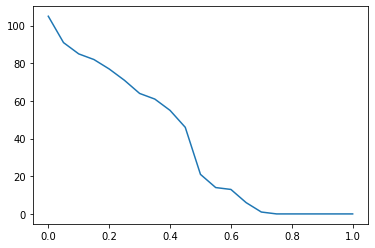

In [26]:
plt.plot(corr_thr_dist.keys(), corr_thr_dist.values())
plt.show()

In [27]:
# plt.hist(corr_thr_dist.values())
# plt.show()

In [28]:
correlation_resutls_reduced, correlation_features_name_reduced = reduce_features_with_correlation(
    correlation_matrix=correlation_matrix_reduced, 
    thr=.06)

In [29]:
rows = ["With Ic", "With Ic_Norm", "With Pos"]
columns = []
corr_results_reduced = pd.DataFrame.from_dict(data=correlation_resutls_reduced, orient='index')



In [30]:
corr_results_reduced


,0,1,2,3,4,5,6,7,8,9,...,83,84,85,86,87,88,89,90,91,92
With Ic,"(mean_Voltage_HSR_V_1025, -0.4155866749531641)","(mean_Voltage_HSR_V_1027, 0.3897812172460986)","(mean_Voltage_HSR_V_1030, 0.41877652972147983)","(mean_Voltage_HSL_V_1025, -0.35051707700686563)","(mean_Voltage_HSL_V_1027, -0.3943607819968929)","(mean_Voltage_HSL_V_1030, 0.3901167340650911)","(mean_Voltage_HF_V_1025, -0.3394784723071121)","(mean_Voltage_HF_V_1027, -0.3693457772685931)","(mean_Voltage_HF_V_1030, 0.4461107925714687)","(mean_Voltage_HC_V_1025, 0.41527767303868546)",...,"(Y FWHM, 0.37073722234589357)","(R FWHM, 0.6265661742488626)","(Coolness, -0.41841231981373983)","(Coolness_neg, 0.4487032005868132)","(Ic_norm, 0.7246221938789872)",None,None,None,None,None
With Ic_Norm,"(mean_Voltage_HSR_V_1025, -0.4220342536727434)","(mean_Voltage_HSR_V_1027, 0.478046088144703)","(mean_Voltage_HSR_V_1030, 0.495949363292186)","(mean_Voltage_HSL_V_1025, -0.253082948088632)","(mean_Voltage_HSL_V_1027, -0.6378317780422623)","(mean_Voltage_HSL_V_1030, 0.4608462930605021)","(mean_Voltage_HF_V_1025, -0.15515290016016842)","(mean_Voltage_HF_V_1027, -0.4674786567167402)","(mean_Voltage_HF_V_1030, 0.5016270149056491)","(mean_Voltage_HC_V_1025, 0.6027429652269396)",...,"(pos, -0.6923768236297467)","(Speed, -0.2156607473205704)","(X FWHM, 0.6304026611288971)","(Y FWHM, 0.6592343015777695)","(R FWHM, 0.5480810551098849)","(Coolness, 0.27202534798008615)","(Coolness_neg, -0.2843542408444804)","(Ic, 0.7246221938789872)",None,None
With Pos,"(mean_Voltage_HSR_V_1025, 0.5827797029556887)","(mean_Voltage_HSR_V_1027, -0.7608447167838319)","(mean_Voltage_HSR_V_1030, -0.7345066233914014)","(mean_Voltage_HSL_V_1025, 0.3080931263934712)","(mean_Voltage_HSL_V_1027, 0.924464525143221)","(mean_Voltage_HSL_V_1030, -0.6936657425275362)","(mean_Voltage_HF_V_1025, 0.4060946233658964)","(mean_Voltage_HF_V_1027, 0.7111248973124739)","(mean_Voltage_HF_V_1030, -0.7134471067248059)","(mean_Voltage_HC_V_1025, -0.8019768503566079)",...,"(mean_Pressure_1025, 0.07639024736875104)","(mean_Sigma_1025, 0.5689617608762919)","(Speed, 0.31073506368586773)","(X FWHM, -0.8672705352845154)","(Y FWHM, -0.8948050248176187)","(R FWHM, -0.8230285246416127)","(Coolness, -0.23180788704140037)","(Coolness_neg, 0.2245055902790741)","(Ic, -0.49330922067590144)","(Ic_norm, -0.6923768236297467)"


In [31]:
dependent_features = correlation_features_name_reduced["With Ic_Norm"]
independent_features = list(set(pld_complete_range_reduced.columns) - set(dependent_features))


In [32]:
len(independent_features) + len(dependent_features) == pld_complete_range_reduced.shape[1]


True

In [33]:
independent_features.remove("Ic_norm")
len(independent_features)


14

In [34]:
x_i = pld_complete_range.loc[:, independent_features]
x_i.head()


,mean_TubeTemp_1027,mean_O2_02_sccm_1025,mean_O2_02_sccm_1027,mean_Pressure_FRG_pa_1025,mean_Sigma_1030,mean_O2_01_sccm_1027,mean_TubeTemp_1025,mean_Temp_HSR_C_1025,mean_Pressure_1027,mean_Egy_1027,mean_O2_01_sccm_1025,mean_Egy_1025,mean_HV_1027,mean_Sigma_1027
0,-0.000591,0.029381,0.076121,0.002802,0.5,0.221031,-0.001609,0.023483,-0.000591,0.000591,-0.076883,-0.000326,-0.000591,-0.000591
1,-0.000591,0.007485,0.136603,-0.032509,0.5,0.222458,-0.001609,0.022873,-0.000591,0.000591,-0.010226,-0.000692,-0.000591,-0.000591
2,-0.000591,0.037030,0.105577,-0.049174,0.5,0.208587,-0.001609,0.015269,-0.000591,0.000591,0.001871,0.012784,-0.000591,-0.000591
3,-0.000591,0.028750,0.088035,-0.044623,0.5,0.216222,-0.001609,0.015624,-0.000591,0.000591,-0.010925,0.011986,-0.000591,-0.000591
4,-0.000591,0.044684,0.024931,-0.044375,0.5,0.144826,-0.001609,0.014941,-0.000591,0.000591,0.049960,0.012632,-0.000591,-0.000591


In [35]:
x_d = pld_complete_range.loc[:, dependent_features]
x_d.head()

,mean_Voltage_HSR_V_1025,mean_Voltage_HSR_V_1027,mean_Voltage_HSR_V_1030,mean_Voltage_HSL_V_1025,mean_Voltage_HSL_V_1027,mean_Voltage_HSL_V_1030,mean_Voltage_HF_V_1025,mean_Voltage_HF_V_1027,mean_Voltage_HF_V_1030,mean_Voltage_HC_V_1025,...,mean_Pressure_1025,mean_Sigma_1025,pos,Speed,X FWHM,Y FWHM,R FWHM,Coolness,Coolness_neg,Ic
0,0.138524,0.135489,0.104463,0.573688,-0.306729,0.103196,-0.011836,-0.036892,0.060546,0.055449,...,0.025859,-0.071758,-0.501695,0.009841,0.039589,0.067470,0.015697,0.053006,-0.086369,496.2
1,0.121958,0.174013,0.104463,0.579175,-0.325816,0.103196,-0.011661,-0.075776,0.060546,0.039791,...,0.033275,-0.063319,-0.501652,-0.005266,0.039589,0.067470,0.015697,0.053006,-0.086369,494.7
2,0.124917,0.171844,0.104463,0.572170,-0.324621,0.103196,-0.011528,-0.069675,0.060546,0.052392,...,0.024406,-0.069940,-0.501646,-0.007197,0.039589,0.067470,0.015697,0.053006,-0.086369,494.2
3,0.124579,0.180113,0.104463,0.571292,-0.327209,0.103196,-0.011712,-0.076901,0.060546,0.049092,...,0.022837,-0.071758,-0.501635,-0.010946,0.039589,0.067470,0.015697,0.053006,-0.086369,495.5
4,0.127446,0.165737,0.104463,0.572985,-0.318481,0.103196,-0.011357,-0.061018,0.060546,0.056544,...,0.019568,-0.071758,-0.501619,-0.017147,0.042682,0.069442,0.017956,0.051965,-0.084836,497.9


In [36]:
y = pld_complete_range.loc[:, "Ic_norm"]
y.head()

0    1.767913
1    1.762568
2    1.760787
3    1.765419
4    1.773168
Name: Ic_norm, dtype: float64

### Splitting data to train and test for evaluation of generated results

In [37]:
np.random.seed(42)
n_samples = pld_complete_range.shape[0]
n_train_samples = int(.7*n_samples)
all_indices = np.arange(n_samples).tolist()
train_indices = np.random.choice(all_indices, n_train_samples, replace=False).tolist()
test_indices = list(set(all_indices) - set(train_indices))


In [38]:
len(set(train_indices)) == len(train_indices)


True

In [39]:
len(set(test_indices)) == len(test_indices)

True

In [40]:
x_d_train = x_d.iloc[train_indices]
x_i_train = x_i.iloc[train_indices]
y_train = pd.DataFrame(y.iloc[train_indices])
x_d_train.shape, x_i_train.shape, y_train.shape

((12992, 91), (12992, 14), (12992, 1))

In [41]:
x_d_test = x_d.iloc[test_indices]
x_i_test = x_i.iloc[test_indices]
y_test = pd.DataFrame(y.iloc[test_indices])

x_d_test.shape, x_i_test.shape, y_test.shape

((5569, 91), (5569, 14), (5569, 1))

In [42]:
print(x_i_test.shape[0] + x_i_train.shape[0] == x_i.shape[0], 
      x_d_test.shape[0] + x_d_train.shape[0] == x_d.shape[0])

True True


In [43]:
def correlation_metric(data1, data2):
    
    if data1.shape[1] != data2.shape[1]:
        print("Matrices should have equal number of features")
        return None

    n_features = data1.shape[1]
    features_correlation = np.zeros([n_features])
    
    for i in range(n_features):
        features_correlation[i] = data1.iloc[:, i].corr(data2.iloc[:, i])
    
    return features_correlation

In [44]:
def eval_generate_data(correlations, thr):  # features_list,
    
    pos_well_generated = []
    pos_bad_generated = []
    neg_well_generated = []
    neg_bad_generated = []


    for i in range(correlations.shape[0]):
        cor_val = correlations[i]
        if cor_val >= 0:
            
            if cor_val >= thr:

                pos_well_generated.append(i)  # features_list[i]

            else:

                pos_bad_generated.append(i)  # features_list[i]
        else:

            if cor_val <= thr:

                neg_well_generated.append(i)  # features_list[i]

            else:

                neg_bad_generated.append(i)  # features_list[i]
                
    
#     print("length check up:", len(pos_well_generated) + len(pos_bad_generated) +
#       len(neg_well_generated) + 
#       len(neg_bad_generated) == x_i_test.shape[1])
    
    print(" ")
    
    print("Well Gen. Pos.:", len(pos_well_generated), "\n"
      "Bad Gen. Pos.:", len(pos_bad_generated),  "\n"
      "Well Gen. Neg.:", len(neg_well_generated), "\n"
      "Bad Gen. Neg.:", len(neg_bad_generated))


    return pos_well_generated, pos_bad_generated, neg_well_generated, neg_bad_generated


### step 3:  GMM and C-GAN

#### fitting GMM:

In [45]:
project = "SuperOX"
data_type = "reduced statistical features-dtw"  # "all statistical features"


In [ ]:
# n_components = set([1, 100, 200, 400, int(2*x_i_train.shape[1])])
# covariance_type = set(["full", "tied", "diag", "spherical"])


In [ ]:
# hyper_params = list(itertools.product(n_components, covariance_type))
# hyper_params




- Except for the above-mentioned parameters, max_iters=250, and n_init=1, the rest of the parameters are fixed to their default values as explained in the link below.


https://scikit-learn.org/stable/modules/generated/sklearn.mixture.GaussianMixture.html

In [46]:
# results = {}

# for hyper_param in hyper_params:
    
#     print(" ")
#     print("n_components:", hyper_param[0], "covariance_type:", hyper_param[1])
    

#     run = init_a_wandb(name= "GMM: " + str(hyper_param),
#                        project=project,
#                        notes="Generating independent features - GMM " + data_type, 
#                        group= "GMM + CGAN - " + data_type  # algorithm
#                       )
    
#     results[hyper_param] = {}
    
#     # fitting gaussian mix
#     gmm = GaussianMixture(n_components=hyper_param[0], 
#                           covariance_type=hyper_param[1],
#                           max_iter=500,
#                           n_init=1
#                          )
#     gmm.fit(X=x_i_train)
    
#     # generating data
#     x_i_new = gmm.sample(int(1.*x_i_test.shape[0]))
    
#     print("Gen x_i shape:", x_i_new[0].shape, 
#           "Gen y shape:", x_i_new[1].shape, )
    
    
#     x_i_hat = pd.DataFrame(x_i_new[0])
#     y_i_hat = pd.DataFrame(x_i_new[1])
    
    
#     run = wandb_metrics(run=run, y_trues=x_i_test, y_preds=x_i_hat)
#     run = wandb_plot_predictions(run=run, algorithm= "gmm: " + str(hyper_param), 
#                                  y_trues=y_test, y_preds=y_i_hat.values.squeeze())
    
#     run = save_model(run=run, 
#                      model=gmm, 
#                      name="gmm", 
#                      experiment_name="gmm 4 x_i -" + data_type + "-" + str(hyper_param)
#                     )  
    
#     # dtw, path = fastdtw(x, y, dist=euclidean)
#     tmp_dtw, _ = fastdtw(x=x_i_test, y=x_i_hat, dist=None)  # dist=None >> abs(x[i]-y[i])
#     results[hyper_param]["samples"] = x_i_new
#     gen_features_correlations = correlation_metric(x_i_test, x_i_hat)
#     results[hyper_param]["correlation"] = gen_features_correlations
#     results[hyper_param]["dtw"] = tmp_dtw

    

#     print("DTW:", tmp_dtw)
#     print(" ")
#     print(" ********************************************************************************** ")
#     print(" ")



In [ ]:
# with open ("../computation results/gmm-study-reduced-dtw.pkl", 'wb') as fp:
#     pickle.dump(results, fp)
    
# results_reduced = results

In [ ]:
# print("finish")

In [47]:
with open("../computation results/gmm-study-reduced-dtw.pkl", 'rb') as fp:
    results_reduced_x_d = pickle.load(fp)

In [ ]:
for k, v in results_reduced_x_d.items():
    print("hyper parameters:", k, ": ", v["dtw"])
#     print(" \t ", "pos_well_generated:", len(v["pos_well_generated"]), "\n", 
#          " \t ", "pos_bad_generated:", len(v["pos_bad_generated"]), "\n",
#           " \t ", "neg_well_generated:", len(v["neg_well_generated"]), "\n",
#           " \t ", "neg_bad_generated:", len(v["neg_bad_generated"]), "\n",        
#          )


#### Conclusion (DTW):

##### Reduced data set:


n_components=200, and Covariance_type=full yield to the minimun DTW=6395.700.

However, there are other similar results obtained by setting n_components >= 28, and using an covariance types except for "spherical".




In [49]:
gmm = GaussianMixture(n_components=200, 
                      covariance_type='full',
                      max_iter=500,
                      n_init=1
                     )
gmm.fit(X=x_i_train)

# generating data
x_i_new = gmm.sample(int(1.*x_i_test.shape[0]))

print("Gen x_i shape:", x_i_new[0].shape, 
      "Gen y shape:", x_i_new[1].shape, )


x_i_hat = pd.DataFrame(x_i_new[0])
y_i_hat = pd.DataFrame(x_i_new[1])

Gen x_i shape: (5569, 14) Gen y shape: (5569,)


### Training GAN


https://github.com/Diyago/GAN-for-tabular-data


https://towardsdatascience.com/review-of-gans-for-tabular-data-a30a2199342







In [50]:
from tabgan.sampler import OriginalGenerator, GANGenerator


In [51]:
max_depth = [1, 4, 8]
max_bin = [10, 100,] 
n_estimators = [ 500, 1000, ]
learning_rate = [.01, .001, .0001]



In [52]:
hyper_params = list(itertools.product(max_depth, max_bin, n_estimators, learning_rate))
hyper_params


[(1, 10, 500, 0.01),
 (1, 10, 500, 0.001),
 (1, 10, 500, 0.0001),
 (1, 10, 1000, 0.01),
 (1, 10, 1000, 0.001),
 (1, 10, 1000, 0.0001),
 (1, 100, 500, 0.01),
 (1, 100, 500, 0.001),
 (1, 100, 500, 0.0001),
 (1, 100, 1000, 0.01),
 (1, 100, 1000, 0.001),
 (1, 100, 1000, 0.0001),
 (4, 10, 500, 0.01),
 (4, 10, 500, 0.001),
 (4, 10, 500, 0.0001),
 (4, 10, 1000, 0.01),
 (4, 10, 1000, 0.001),
 (4, 10, 1000, 0.0001),
 (4, 100, 500, 0.01),
 (4, 100, 500, 0.001),
 (4, 100, 500, 0.0001),
 (4, 100, 1000, 0.01),
 (4, 100, 1000, 0.001),
 (4, 100, 1000, 0.0001),
 (8, 10, 500, 0.01),
 (8, 10, 500, 0.001),
 (8, 10, 500, 0.0001),
 (8, 10, 1000, 0.01),
 (8, 10, 1000, 0.001),
 (8, 10, 1000, 0.0001),
 (8, 100, 500, 0.01),
 (8, 100, 500, 0.001),
 (8, 100, 500, 0.0001),
 (8, 100, 1000, 0.01),
 (8, 100, 1000, 0.001),
 (8, 100, 1000, 0.0001)]

In [ ]:
# results_x_d = {}

# for hyper_param in hyper_params:
    
#     print(" ")
#     print("max_depth:", hyper_param[0],
#           "max_bin:", hyper_param[1], 
#           "n_estimators:", hyper_param[2], 
#           "learning_rate:", hyper_param[3]
#          )
    

#     run = init_a_wandb(name= "TGAN: " + str(hyper_param),
#                        project=project,
#                        notes="Generating dependent features - TGAN " + data_type, 
#                        group= "GMM + CGAN - " + data_type  # algorithm
#                       )
    
#     results_x_d[hyper_param] = {}
    
#     # Training TGAN and generating data
#     x_d_cgan, y_cgan = GANGenerator(gen_x_times=1.2,  # how much data to generate, output might be less because of postprocessing and adversarial filtering
#                                     adversaial_model_params={
#                                         "metrics": "AUC", 
#                                         "max_depth": hyper_param[0],
#                                         "max_bin": hyper_param[1],
#                                         "n_estimators": hyper_param[2],
#                                         "learning_rate": hyper_param[3], 
#                                         "random_state": 42,},
#                                     epochs=500).generate_data_pipe(x_d_train, y_train,
#                                                                x_d_test, deep_copy=True,
#                                                                use_adversarial=True)
    
    
    
#     print("Gen x_d shape:", x_d_cgan.shape, 
#           "Gen y shape:", y_cgan.shape, )
    
    
#     x_d_hat = pd.DataFrame(x_d_cgan)
#     y_d_hat = pd.DataFrame(y_cgan)
#     n_samples = x_d_test.shape[0]
#     rnd_idx = np.random.randint(low=0, high=x_d_cgan.shape[0], size=n_samples)
    
#     x_d_hat = x_d_hat.iloc[rnd_idx, :]
#     y_d_hat = y_d_hat.iloc[rnd_idx, :]
    
#     run = wandb_metrics(run=run, y_trues=x_d_test, y_preds=x_d_hat)

    
# #     run = save_model(run=run, 
# #                      model=GANGenerator, 
# #                      name="TGAN", 
# #                      experiment_name="gan 4 x_d -" + data_type + "-" + str(hyper_param)
# #                     )  


#     tmp_dtw_d, _ = fastdtw(x=x_d_test, y=x_d_hat, dist=None)  # dist=None >> abs(x[i]-y[i])
#     results_x_d[hyper_param]["samples"] = x_d_cgan
#     gen_features_correlations = correlation_metric(x_d_test, x_d_hat)
#     results_x_d[hyper_param]["correlation"] = gen_features_correlations
#     results_x_d[hyper_param]["dtw"] = tmp_dtw_d

    
#     print(" ")
#     print(" ********************************************************************************** ")
    

 
max_depth: 1 max_bin: 10 n_estimators: 500 learning_rate: 0.01


wandb: Currently logged in as: sorooshi (use `wandb login --relogin` to force relogin)
wandb: wandb version 0.10.31 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


CUDA initialization: The NVIDIA driver on your system is too old (found version 10000). Please update your GPU driver by downloading and installing a new version from the URL: http://www.nvidia.com/Download/index.aspx Alternatively, go to: https://pytorch.org to install a PyTorch version that has been compiled with your version of the CUDA driver. (Triggered internally at  /pytorch/c10/cuda/CUDAFunctions.cpp:109.)


Gen x_d shape: (11822, 91) Gen y shape: (11822,)


divide by zero encountered in true_divide
invalid value encountered in true_divide


 
 ********************************************************************************** 
 
max_depth: 1 max_bin: 10 n_estimators: 500 learning_rate: 0.001


MAE,0.29453
MRAE,nan
RMSE,1.5651
R^2-Score,-0.93521
DTW,140685.66931
_runtime,906
_timestamp,1622453561
_step,0


MAE,▁
MRAE,
RMSE,▁
R^2-Score,▁
DTW,▁
_runtime,▁
_timestamp,▁
_step,▁


wandb: wandb version 0.10.31 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


Gen x_d shape: (11822, 91) Gen y shape: (11822,)


divide by zero encountered in true_divide
invalid value encountered in true_divide


 
 ********************************************************************************** 
 
max_depth: 1 max_bin: 10 n_estimators: 500 learning_rate: 0.0001


MAE,0.29555
MRAE,nan
RMSE,1.59303
R^2-Score,-0.93878
DTW,140506.38044
_runtime,861
_timestamp,1622454426
_step,0


MAE,▁
MRAE,
RMSE,▁
R^2-Score,▁
DTW,▁
_runtime,▁
_timestamp,▁
_step,▁


wandb: wandb version 0.10.31 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


Gen x_d shape: (11822, 91) Gen y shape: (11822,)


divide by zero encountered in true_divide
invalid value encountered in true_divide


 
 ********************************************************************************** 
 
max_depth: 1 max_bin: 10 n_estimators: 1000 learning_rate: 0.01


MAE,0.29162
MRAE,nan
RMSE,1.56648
R^2-Score,-0.88905
DTW,141271.61097
_runtime,887
_timestamp,1622455316
_step,0


MAE,▁
MRAE,
RMSE,▁
R^2-Score,▁
DTW,▁
_runtime,▁
_timestamp,▁
_step,▁


wandb: wandb version 0.10.31 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


Gen x_d shape: (11822, 91) Gen y shape: (11822,)


divide by zero encountered in true_divide
invalid value encountered in true_divide


 
 ********************************************************************************** 
 
max_depth: 1 max_bin: 10 n_estimators: 1000 learning_rate: 0.001


MAE,0.29287
MRAE,nan
RMSE,1.57165
R^2-Score,-0.90881
DTW,139215.4284
_runtime,869
_timestamp,1622456189
_step,0


MAE,▁
MRAE,
RMSE,▁
R^2-Score,▁
DTW,▁
_runtime,▁
_timestamp,▁
_step,▁


wandb: wandb version 0.10.31 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


Gen x_d shape: (11822, 91) Gen y shape: (11822,)


divide by zero encountered in true_divide
invalid value encountered in true_divide


 
 ********************************************************************************** 
 
max_depth: 1 max_bin: 10 n_estimators: 1000 learning_rate: 0.0001


MAE,0.29699
MRAE,nan
RMSE,1.59785
R^2-Score,-0.93824
DTW,140474.78418
_runtime,912
_timestamp,1622457106
_step,0


MAE,▁
MRAE,
RMSE,▁
R^2-Score,▁
DTW,▁
_runtime,▁
_timestamp,▁
_step,▁


wandb: wandb version 0.10.31 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


Gen x_d shape: (11823, 91) Gen y shape: (11823,)


divide by zero encountered in true_divide
invalid value encountered in true_divide


 
 ********************************************************************************** 
 
max_depth: 1 max_bin: 100 n_estimators: 500 learning_rate: 0.01


MAE,0.29636
MRAE,nan
RMSE,1.57965
R^2-Score,-0.95268
DTW,143031.58115
_runtime,883
_timestamp,1622457993
_step,0


MAE,▁
MRAE,
RMSE,▁
R^2-Score,▁
DTW,▁
_runtime,▁
_timestamp,▁
_step,▁


wandb: wandb version 0.10.31 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


Gen x_d shape: (11822, 91) Gen y shape: (11822,)


divide by zero encountered in true_divide
invalid value encountered in true_divide


 
 ********************************************************************************** 
 
max_depth: 1 max_bin: 100 n_estimators: 500 learning_rate: 0.001


MAE,0.296
MRAE,nan
RMSE,1.59392
R^2-Score,-0.91271
DTW,141045.90481
_runtime,910
_timestamp,1622458906
_step,0


MAE,▁
MRAE,
RMSE,▁
R^2-Score,▁
DTW,▁
_runtime,▁
_timestamp,▁
_step,▁


wandb: wandb version 0.10.31 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


Gen x_d shape: (11823, 91) Gen y shape: (11823,)


divide by zero encountered in true_divide
invalid value encountered in true_divide


 
 ********************************************************************************** 
 
max_depth: 1 max_bin: 100 n_estimators: 500 learning_rate: 0.0001


MAE,0.29475
MRAE,nan
RMSE,1.58351
R^2-Score,-0.91718
DTW,140193.69996
_runtime,891
_timestamp,1622459801
_step,0


MAE,▁
MRAE,
RMSE,▁
R^2-Score,▁
DTW,▁
_runtime,▁
_timestamp,▁
_step,▁


wandb: wandb version 0.10.31 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


Gen x_d shape: (11822, 91) Gen y shape: (11822,)


divide by zero encountered in true_divide
invalid value encountered in true_divide


 
 ********************************************************************************** 
 
max_depth: 1 max_bin: 100 n_estimators: 1000 learning_rate: 0.01


MAE,0.29112
MRAE,nan
RMSE,1.56569
R^2-Score,-0.88642
DTW,139477.4119
_runtime,880
_timestamp,1622460684
_step,0


MAE,▁
MRAE,
RMSE,▁
R^2-Score,▁
DTW,▁
_runtime,▁
_timestamp,▁
_step,▁


wandb: wandb version 0.10.31 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


Gen x_d shape: (11823, 91) Gen y shape: (11823,)


divide by zero encountered in true_divide
invalid value encountered in true_divide


 
 ********************************************************************************** 
 
max_depth: 1 max_bin: 100 n_estimators: 1000 learning_rate: 0.001


MAE,0.29575
MRAE,nan
RMSE,1.58207
R^2-Score,-0.93517
DTW,142010.28377
_runtime,870
_timestamp,1622461559
_step,0


MAE,▁
MRAE,
RMSE,▁
R^2-Score,▁
DTW,▁
_runtime,▁
_timestamp,▁
_step,▁


wandb: wandb version 0.10.31 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


Gen x_d shape: (11823, 91) Gen y shape: (11823,)


divide by zero encountered in true_divide
invalid value encountered in true_divide


 
 ********************************************************************************** 
 
max_depth: 1 max_bin: 100 n_estimators: 1000 learning_rate: 0.0001


MAE,0.29263
MRAE,nan
RMSE,1.56392
R^2-Score,-0.90125
DTW,139677.92263
_runtime,915
_timestamp,1622462477
_step,0


MAE,▁
MRAE,
RMSE,▁
R^2-Score,▁
DTW,▁
_runtime,▁
_timestamp,▁
_step,▁


wandb: wandb version 0.10.31 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


Gen x_d shape: (11822, 91) Gen y shape: (11822,)


divide by zero encountered in true_divide
invalid value encountered in true_divide


 
 ********************************************************************************** 
 
max_depth: 4 max_bin: 10 n_estimators: 500 learning_rate: 0.01


MAE,0.29518
MRAE,nan
RMSE,1.57458
R^2-Score,-0.94371
DTW,142011.74932
_runtime,897
_timestamp,1622463379
_step,0


MAE,▁
MRAE,
RMSE,▁
R^2-Score,▁
DTW,▁
_runtime,▁
_timestamp,▁
_step,▁


wandb: wandb version 0.10.31 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


Gen x_d shape: (11822, 91) Gen y shape: (11822,)


divide by zero encountered in true_divide
invalid value encountered in true_divide


 
 ********************************************************************************** 
 
max_depth: 4 max_bin: 10 n_estimators: 500 learning_rate: 0.001


MAE,0.29555
MRAE,nan
RMSE,1.59383
R^2-Score,-0.9285
DTW,141870.08506
_runtime,906
_timestamp,1622464288
_step,0


MAE,▁
MRAE,
RMSE,▁
R^2-Score,▁
DTW,▁
_runtime,▁
_timestamp,▁
_step,▁


wandb: wandb version 0.10.31 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


Gen x_d shape: (11822, 91) Gen y shape: (11822,)


divide by zero encountered in true_divide
invalid value encountered in true_divide


 
 ********************************************************************************** 
 
max_depth: 4 max_bin: 10 n_estimators: 500 learning_rate: 0.0001


MAE,0.29408
MRAE,nan
RMSE,1.58275
R^2-Score,-0.90551
DTW,141190.01814
_runtime,869
_timestamp,1622465160
_step,0


MAE,▁
MRAE,
RMSE,▁
R^2-Score,▁
DTW,▁
_runtime,▁
_timestamp,▁
_step,▁


wandb: wandb version 0.10.31 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


Gen x_d shape: (11822, 91) Gen y shape: (11822,)


divide by zero encountered in true_divide
invalid value encountered in true_divide


 
 ********************************************************************************** 
 
max_depth: 4 max_bin: 10 n_estimators: 1000 learning_rate: 0.01


MAE,0.29498
MRAE,nan
RMSE,1.57876
R^2-Score,-0.9284
DTW,140649.53523
_runtime,932
_timestamp,1622466094
_step,0


MAE,▁
MRAE,
RMSE,▁
R^2-Score,▁
DTW,▁
_runtime,▁
_timestamp,▁
_step,▁


wandb: wandb version 0.10.31 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


Gen x_d shape: (11822, 91) Gen y shape: (11822,)


divide by zero encountered in true_divide
invalid value encountered in true_divide


 
 ********************************************************************************** 
 
max_depth: 4 max_bin: 10 n_estimators: 1000 learning_rate: 0.001


MAE,0.29379
MRAE,nan
RMSE,1.56922
R^2-Score,-0.91276
DTW,138851.23949
_runtime,922
_timestamp,1622467019
_step,0


MAE,▁
MRAE,
RMSE,▁
R^2-Score,▁
DTW,▁
_runtime,▁
_timestamp,▁
_step,▁


wandb: wandb version 0.10.31 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


Gen x_d shape: (11822, 91) Gen y shape: (11822,)


divide by zero encountered in true_divide
invalid value encountered in true_divide


 
 ********************************************************************************** 
 
max_depth: 4 max_bin: 10 n_estimators: 1000 learning_rate: 0.0001


MAE,0.29278
MRAE,nan
RMSE,1.58105
R^2-Score,-0.89468
DTW,138258.46296
_runtime,872
_timestamp,1622467894
_step,0


MAE,▁
MRAE,
RMSE,▁
R^2-Score,▁
DTW,▁
_runtime,▁
_timestamp,▁
_step,▁


wandb: wandb version 0.10.31 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


Gen x_d shape: (11822, 91) Gen y shape: (11822,)


divide by zero encountered in true_divide
invalid value encountered in true_divide


 
 ********************************************************************************** 
 
max_depth: 4 max_bin: 100 n_estimators: 500 learning_rate: 0.01


MAE,0.29467
MRAE,nan
RMSE,1.57843
R^2-Score,-0.91672
DTW,139231.63932
_runtime,932
_timestamp,1622468830
_step,0


MAE,▁
MRAE,
RMSE,▁
R^2-Score,▁
DTW,▁
_runtime,▁
_timestamp,▁
_step,▁


wandb: wandb version 0.10.31 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


Gen x_d shape: (11822, 91) Gen y shape: (11822,)


divide by zero encountered in true_divide
invalid value encountered in true_divide


 
 ********************************************************************************** 
 
max_depth: 4 max_bin: 100 n_estimators: 500 learning_rate: 0.001


MAE,0.29571
MRAE,nan
RMSE,1.57674
R^2-Score,-0.94281
DTW,143031.19698
_runtime,941
_timestamp,1622469775
_step,0


MAE,▁
MRAE,
RMSE,▁
R^2-Score,▁
DTW,▁
_runtime,▁
_timestamp,▁
_step,▁


wandb: wandb version 0.10.31 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


Gen x_d shape: (11822, 91) Gen y shape: (11822,)


divide by zero encountered in true_divide
invalid value encountered in true_divide


 
 ********************************************************************************** 
 
max_depth: 4 max_bin: 100 n_estimators: 500 learning_rate: 0.0001


MAE,0.29573
MRAE,nan
RMSE,1.57866
R^2-Score,-0.9197
DTW,141358.84634
_runtime,888
_timestamp,1622470667
_step,0


MAE,▁
MRAE,
RMSE,▁
R^2-Score,▁
DTW,▁
_runtime,▁
_timestamp,▁
_step,▁


wandb: wandb version 0.10.31 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


Gen x_d shape: (11822, 91) Gen y shape: (11822,)


divide by zero encountered in true_divide
invalid value encountered in true_divide


 
 ********************************************************************************** 
 
max_depth: 4 max_bin: 100 n_estimators: 1000 learning_rate: 0.01


MAE,0.29365
MRAE,nan
RMSE,1.58719
R^2-Score,-0.91687
DTW,139641.91182
_runtime,905
_timestamp,1622471576
_step,0


MAE,▁
MRAE,
RMSE,▁
R^2-Score,▁
DTW,▁
_runtime,▁
_timestamp,▁
_step,▁


wandb: wandb version 0.10.31 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


Gen x_d shape: (11822, 91) Gen y shape: (11822,)


divide by zero encountered in true_divide
invalid value encountered in true_divide


 
 ********************************************************************************** 
 
max_depth: 4 max_bin: 100 n_estimators: 1000 learning_rate: 0.001


MAE,0.29427
MRAE,nan
RMSE,1.57728
R^2-Score,-0.91922
DTW,140879.45595
_runtime,868
_timestamp,1622472448
_step,0


MAE,▁
MRAE,
RMSE,▁
R^2-Score,▁
DTW,▁
_runtime,▁
_timestamp,▁
_step,▁


wandb: wandb version 0.10.31 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


Gen x_d shape: (11822, 91) Gen y shape: (11822,)


divide by zero encountered in true_divide
invalid value encountered in true_divide


 
 ********************************************************************************** 
 
max_depth: 4 max_bin: 100 n_estimators: 1000 learning_rate: 0.0001


MAE,0.29575
MRAE,nan
RMSE,1.57992
R^2-Score,-0.93293
DTW,141419.48472
_runtime,903
_timestamp,1622473354
_step,0


MAE,▁
MRAE,
RMSE,▁
R^2-Score,▁
DTW,▁
_runtime,▁
_timestamp,▁
_step,▁


wandb: wandb version 0.10.31 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


Gen x_d shape: (11823, 91) Gen y shape: (11823,)


divide by zero encountered in true_divide
invalid value encountered in true_divide


 
 ********************************************************************************** 
 
max_depth: 8 max_bin: 10 n_estimators: 500 learning_rate: 0.01


MAE,0.29192
MRAE,nan
RMSE,1.54596
R^2-Score,-0.90192
DTW,138734.98047
_runtime,938
_timestamp,1622474296
_step,0


MAE,▁
MRAE,
RMSE,▁
R^2-Score,▁
DTW,▁
_runtime,▁
_timestamp,▁
_step,▁


wandb: wandb version 0.10.31 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


Gen x_d shape: (11822, 91) Gen y shape: (11822,)


divide by zero encountered in true_divide
invalid value encountered in true_divide


 
 ********************************************************************************** 
 
max_depth: 8 max_bin: 10 n_estimators: 500 learning_rate: 0.001


MAE,0.2942
MRAE,nan
RMSE,1.5836
R^2-Score,-0.91827
DTW,139666.3612
_runtime,864
_timestamp,1622475163
_step,0


MAE,▁
MRAE,
RMSE,▁
R^2-Score,▁
DTW,▁
_runtime,▁
_timestamp,▁
_step,▁


wandb: wandb version 0.10.31 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


Gen x_d shape: (11822, 91) Gen y shape: (11822,)


divide by zero encountered in true_divide
invalid value encountered in true_divide


 
 ********************************************************************************** 
 
max_depth: 8 max_bin: 10 n_estimators: 500 learning_rate: 0.0001


MAE,0.2975
MRAE,nan
RMSE,1.57409
R^2-Score,-0.9712
DTW,141480.82086
_runtime,875
_timestamp,1622476042
_step,0


MAE,▁
MRAE,
RMSE,▁
R^2-Score,▁
DTW,▁
_runtime,▁
_timestamp,▁
_step,▁


wandb: wandb version 0.10.31 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


In [60]:
with open ("../computation results/tgan-study-reduced-dtw.pkl", 'wb') as fp:
    pickle.dump(results_x_d, fp)
    

In [61]:
print("finish")


finish


In [62]:
for k, v  in results_x_d.items():
    print("hyper parameters:", k, ": ", v["dtw"])

hyper parameters: (1, 10, 500, 0.01) :  140685.66931490213
hyper parameters: (1, 10, 500, 0.001) :  140506.38043716166
hyper parameters: (1, 10, 500, 0.0001) :  141271.61096680956
hyper parameters: (1, 10, 1000, 0.01) :  139215.42840484908
hyper parameters: (1, 10, 1000, 0.001) :  140474.78417941945
hyper parameters: (1, 10, 1000, 0.0001) :  143031.581149601
hyper parameters: (1, 100, 500, 0.01) :  141045.90481061686
hyper parameters: (1, 100, 500, 0.001) :  140193.69996382832
hyper parameters: (1, 100, 500, 0.0001) :  139477.41190462885
hyper parameters: (1, 100, 1000, 0.01) :  142010.28377035228
hyper parameters: (1, 100, 1000, 0.001) :  139677.92262868868
hyper parameters: (1, 100, 1000, 0.0001) :  142011.7493220139
hyper parameters: (4, 10, 500, 0.01) :  141870.08505603764
hyper parameters: (4, 10, 500, 0.001) :  141190.01814097937
hyper parameters: (4, 10, 500, 0.0001) :  140649.53523435895
hyper parameters: (4, 10, 1000, 0.01) :  138851.23948605184
hyper parameters: (4, 10, 1000,

The best results that is 13 neg_well_generated=13 while other are zeros, obtained with the following setting:


- hyper parameters: (4, 10, 1000, 0.001) :  138258.4629552774

- hyper parameters: (4, 10, 1000, 0.01) :  138851.23948605184
 
 I'll choose the first one because of faster execution time

In [63]:
# Training TGAN and generating data
x_d_cgan, y_cgan = GANGenerator(gen_x_times=1.2,  # how much data to generate, output might be less because of postprocessing and adversarial filtering
                                adversaial_model_params={
                                    "metrics": "AUC", 
                                    "max_depth": 4,
                                    "max_bin": 10,
                                    "n_estimators": 1000,
                                    "learning_rate": 0.001, 
                                    "random_state": 42,},
                                epochs=500).generate_data_pipe(x_d_train, y_train,
                                                               x_d_test, deep_copy=True,
                                                               use_adversarial=True)



print("Gen x_d shape:", x_d_cgan.shape, 
      "Gen y shape:", y_cgan.shape, )


x_d_hat = pd.DataFrame(x_d_cgan)
y_d_hat = pd.DataFrame(y_cgan)
n_samples = x_d_test.shape[0]
rnd_idx = np.random.randint(low=0, high=x_d_cgan.shape[0], size=n_samples)

x_d_hat = x_d_hat.iloc[rnd_idx, :]
y_d_hat = y_d_hat.iloc[rnd_idx, :]


Gen x_d shape: (11822, 91) Gen y shape: (11822,)


## Integrating the generated datasets

In [64]:
x_i_new = gmm.sample(x_d_cgan.shape[0])
x_i_gmm = pd.DataFrame(x_i_new[0], columns=independent_features)
x_i_gmm.head()

,mean_TubeTemp_1027,mean_O2_02_sccm_1025,mean_O2_02_sccm_1027,mean_Pressure_FRG_pa_1025,mean_Sigma_1030,mean_O2_01_sccm_1027,mean_TubeTemp_1025,mean_Temp_HSR_C_1025,mean_Pressure_1027,mean_Egy_1027,mean_O2_01_sccm_1025,mean_Egy_1025,mean_HV_1027,mean_Sigma_1027
0,-0.001544,0.024623,0.140524,0.175356,0.500687,-0.022012,-0.183089,-0.214795,0.000293,0.000847,0.149977,-0.037778,0.000202,-0.001441
1,-0.000948,-0.035405,-0.028469,0.054689,0.500570,-0.069658,0.078573,-0.342477,-0.001612,-0.001381,-0.033841,0.063927,0.000189,0.000487
2,-0.001446,-0.037822,-0.174773,0.160432,0.500232,-0.016592,0.166621,-0.221515,0.000621,0.000887,0.051515,-0.076730,-0.000514,-0.000173
3,-0.000368,0.052818,-0.011380,0.134886,0.499004,-0.055984,-0.188707,-0.305810,-0.000585,0.001599,0.117280,-0.015783,-0.000168,0.000412
4,0.001293,0.015177,-0.113820,0.150899,0.499183,0.040580,0.036604,-0.260997,-0.000493,0.001325,0.051054,0.007143,-0.002706,-0.000793


In [65]:
x_d_cgan.head()

,mean_Voltage_HSR_V_1025,mean_Voltage_HSR_V_1027,mean_Voltage_HSR_V_1030,mean_Voltage_HSL_V_1025,mean_Voltage_HSL_V_1027,mean_Voltage_HSL_V_1030,mean_Voltage_HF_V_1025,mean_Voltage_HF_V_1027,mean_Voltage_HF_V_1030,mean_Voltage_HC_V_1025,...,mean_Pressure_1025,mean_Sigma_1025,pos,Speed,X FWHM,Y FWHM,R FWHM,Coolness,Coolness_neg,Ic
0,-0.152283,0.109640,0.102991,-0.184230,0.211138,0.116389,-0.049582,-0.246483,0.077074,0.212713,...,0.310207,0.053141,0.018572,0.039798,0.025204,0.031878,-0.015576,0.058645,-0.093008,482.6
1,-0.151354,0.183515,0.103885,-0.062704,-0.187417,0.123752,-0.044721,-0.234562,0.070546,0.186953,...,-0.217507,0.024384,-0.193981,-0.021847,0.041593,0.059954,0.045333,0.004090,-0.008878,493.3
2,-0.192614,0.162143,0.100966,-0.143423,0.170252,0.119398,-0.045614,-0.225353,0.077962,0.143077,...,-0.147221,0.060233,0.031682,-0.037110,0.015816,0.007668,0.012268,-0.005429,0.013190,489.3
3,-0.189726,0.154641,0.101051,-0.144210,0.172507,0.119228,-0.045725,-0.222584,0.077984,0.144284,...,-0.151516,0.079462,0.031714,-0.028580,0.009856,0.012446,0.010442,0.002144,0.000676,489.6
4,-0.210330,0.022342,0.101105,-0.196851,0.225835,0.116208,-0.048525,-0.211994,0.080076,0.155131,...,-0.027142,-0.059366,0.019919,-0.016703,0.010818,0.024132,-0.023463,0.061366,-0.097039,477.3


In [66]:
y_cgan = pd.DataFrame(y_cgan, columns=['Ic_norm'])
y_cgan.head()

,Ic_norm
0,1.722848
1,1.720216
2,1.696696
3,1.703116
4,1.705984


In [76]:
x_i_gmm.shape, x_d_cgan.shape, y_cgan.shape



((11822, 14), (11822, 91), (11822, 1))

In [82]:
x_synthetic_gmm_gan = pd.concat([x_i_gmm, x_d_cgan], ignore_index=False, axis=1)



In [83]:
x_synthetic_gmm_gan.shape



(11822, 105)

In [85]:
x_synthetic_gmm_gan.head()



,mean_TubeTemp_1027,mean_O2_02_sccm_1025,mean_O2_02_sccm_1027,mean_Pressure_FRG_pa_1025,mean_Sigma_1030,mean_O2_01_sccm_1027,mean_TubeTemp_1025,mean_Temp_HSR_C_1025,mean_Pressure_1027,mean_Egy_1027,...,mean_Pressure_1025,mean_Sigma_1025,pos,Speed,X FWHM,Y FWHM,R FWHM,Coolness,Coolness_neg,Ic
0,-0.001544,0.024623,0.140524,0.175356,0.500687,-0.022012,-0.183089,-0.214795,0.000293,0.000847,...,0.310207,0.053141,0.018572,0.039798,0.025204,0.031878,-0.015576,0.058645,-0.093008,482.6
1,-0.000948,-0.035405,-0.028469,0.054689,0.500570,-0.069658,0.078573,-0.342477,-0.001612,-0.001381,...,-0.217507,0.024384,-0.193981,-0.021847,0.041593,0.059954,0.045333,0.004090,-0.008878,493.3
2,-0.001446,-0.037822,-0.174773,0.160432,0.500232,-0.016592,0.166621,-0.221515,0.000621,0.000887,...,-0.147221,0.060233,0.031682,-0.037110,0.015816,0.007668,0.012268,-0.005429,0.013190,489.3
3,-0.000368,0.052818,-0.011380,0.134886,0.499004,-0.055984,-0.188707,-0.305810,-0.000585,0.001599,...,-0.151516,0.079462,0.031714,-0.028580,0.009856,0.012446,0.010442,0.002144,0.000676,489.6
4,0.001293,0.015177,-0.113820,0.150899,0.499183,0.040580,0.036604,-0.260997,-0.000493,0.001325,...,-0.027142,-0.059366,0.019919,-0.016703,0.010818,0.024132,-0.023463,0.061366,-0.097039,477.3


In [86]:
x_synthetic_gmm_gan.to_csv("../../data/x_r_synthetic_gmm_gan-dtw.csv")



In [87]:
x_synthetic_gmm_gan_ = pd.read_csv("../../data/x_r_synthetic_gmm_gan-dtw.csv",
                                   index_col=False)
x_synthetic_gmm_gan_



,Unnamed: 0,mean_TubeTemp_1027,mean_O2_02_sccm_1025,mean_O2_02_sccm_1027,mean_Pressure_FRG_pa_1025,mean_Sigma_1030,mean_O2_01_sccm_1027,mean_TubeTemp_1025,mean_Temp_HSR_C_1025,mean_Pressure_1027,...,mean_Pressure_1025,mean_Sigma_1025,pos,Speed,X FWHM,Y FWHM,R FWHM,Coolness,Coolness_neg,Ic
0,0,-0.001544,0.024623,0.140524,0.175356,0.500687,-0.022012,-0.183089,-0.214795,0.000293,...,0.310207,0.053141,0.018572,0.039798,0.025204,0.031878,-0.015576,0.058645,-0.093008,482.6
1,1,-0.000948,-0.035405,-0.028469,0.054689,0.500570,-0.069658,0.078573,-0.342477,-0.001612,...,-0.217507,0.024384,-0.193981,-0.021847,0.041593,0.059954,0.045333,0.004090,-0.008878,493.3
2,2,-0.001446,-0.037822,-0.174773,0.160432,0.500232,-0.016592,0.166621,-0.221515,0.000621,...,-0.147221,0.060233,0.031682,-0.037110,0.015816,0.007668,0.012268,-0.005429,0.013190,489.3
3,3,-0.000368,0.052818,-0.011380,0.134886,0.499004,-0.055984,-0.188707,-0.305810,-0.000585,...,-0.151516,0.079462,0.031714,-0.028580,0.009856,0.012446,0.010442,0.002144,0.000676,489.6
4,4,0.001293,0.015177,-0.113820,0.150899,0.499183,0.040580,0.036604,-0.260997,-0.000493,...,-0.027142,-0.059366,0.019919,-0.016703,0.010818,0.024132,-0.023463,0.061366,-0.097039,477.3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11817,11817,-0.000397,-0.245860,-0.028886,-0.116669,0.500477,-0.117707,-0.241313,-0.069151,-0.001813,...,-0.470203,-0.024502,-0.112506,0.073012,-0.012632,-0.020844,-0.016987,-0.000476,0.001177,495.4
11818,11818,-0.001802,-0.168006,-0.077027,-0.053534,0.500127,-0.106249,-0.173623,-0.085212,0.000535,...,-0.134153,0.259035,-0.128577,-0.045020,0.049865,0.032753,0.023955,0.004913,-0.006484,496.9
11819,11819,-0.001509,-0.100598,-0.162336,0.084401,0.500491,0.076707,0.001472,-0.056610,0.000183,...,0.233496,0.181486,-0.104779,-0.172046,-0.001058,0.002352,-0.020560,0.032166,-0.049843,497.6
11820,11820,-0.001799,-0.300119,-0.013222,-0.023039,0.499885,-0.133230,-0.195103,-0.146637,0.000116,...,-0.417628,-0.024502,-0.112629,-0.024196,-0.025146,-0.028821,-0.010579,-0.017232,0.029988,497.3


In [335]:
x_synthetic_gmm_gan = x_synthetic_gmm_cgan_.iloc[:, 1:-1]  # removing mistakenly saved indices and 
x_synthetic_gmm_gan.head()


,mean_TubeTemp_1027,mean_O2_02_sccm_1025,mean_O2_02_sccm_1027,mean_Pressure_FRG_pa_1025,mean_Sigma_1030,mean_O2_01_sccm_1027,mean_TubeTemp_1025,mean_Temp_HSR_C_1025,mean_Pressure_1027,mean_Egy_1027,...,mean_Egy_1030,mean_Pressure_1025,mean_Sigma_1025,pos,Speed,X FWHM,Y FWHM,R FWHM,Coolness,Coolness_neg
0,-0.001544,0.024623,0.140524,0.175356,0.500687,-0.022012,-0.183089,-0.214795,0.000293,0.000847,...,-0.75,0.310207,0.053141,0.018572,0.039798,0.025204,0.031878,-0.015576,0.058645,-0.093008
1,-0.000948,-0.035405,-0.028469,0.054689,0.500570,-0.069658,0.078573,-0.342477,-0.001612,-0.001381,...,-0.50,-0.217507,0.024384,-0.193981,-0.021847,0.041593,0.059954,0.045333,0.004090,-0.008878
2,-0.001446,-0.037822,-0.174773,0.160432,0.500232,-0.016592,0.166621,-0.221515,0.000621,0.000887,...,-0.50,-0.147221,0.060233,0.031682,-0.037110,0.015816,0.007668,0.012268,-0.005429,0.013190
3,-0.000368,0.052818,-0.011380,0.134886,0.499004,-0.055984,-0.188707,-0.305810,-0.000585,0.001599,...,-0.50,-0.151516,0.079462,0.031714,-0.028580,0.009856,0.012446,0.010442,0.002144,0.000676
4,0.001293,0.015177,-0.113820,0.150899,0.499183,0.040580,0.036604,-0.260997,-0.000493,0.001325,...,-0.50,-0.027142,-0.059366,0.019919,-0.016703,0.010818,0.024132,-0.023463,0.061366,-0.097039


### Loading the saved data by training the RF

- For more see: https://gitlab.com/lambda-hse/superox/ko-vstp-ml/-/blob/sets_aligner/notebooks/u01-data-generation.ipynb


In [509]:
# rf_reg = RandomForestRegressor(n_estimators=100, 
#                                n_jobs = 3, 
#                                criterion='mse', 
#                                min_samples_leaf=1,
#                                verbose=1)
# rf_reg.fit(x_r_train, x_r_train)

In [334]:
x_synthetic_rf = np.loadtxt("../../data/x_r_synthetic.npy")
x_synthetic_rf.shape



(18561, 379)

In [337]:
x_synthetic_rf = pd.DataFrame(x_synthetic_rf, columns=features_name)
x_synthetic_rf.head()

,median_Voltage_HSR_V_1025,median_Voltage_HSR_V_1027,median_Voltage_HSR_V_1030,median_Voltage_HSL_V_1025,median_Voltage_HSL_V_1027,median_Voltage_HSL_V_1030,median_Voltage_HF_V_1025,median_Voltage_HF_V_1027,median_Voltage_HF_V_1030,median_Voltage_HC_V_1025,...,std_Sigma_1030,pos,Speed,X FWHM,Y FWHM,R FWHM,Coolness,Coolness_neg,Ic,Ic_norm
0,0.116585,0.093739,0.043791,0.513412,-0.330393,-0.043560,-0.003032,-0.079799,0.002611,0.075710,...,-0.370973,-0.509167,-0.023762,0.042741,0.034811,0.053434,0.073134,-0.160736,496.197784,1.816964
1,0.099598,0.208231,0.042163,0.517331,-0.369798,-0.055863,0.020953,-0.129239,0.002425,0.073415,...,-0.383919,-0.493918,-0.007931,0.050225,0.041402,0.044444,0.077865,-0.155136,494.696869,1.808321
2,0.088980,0.205039,0.031264,0.516343,-0.377708,-0.055534,0.031307,-0.126762,0.007994,0.076990,...,-0.396096,-0.497284,-0.007428,0.043293,0.041250,0.049600,0.077555,-0.151894,494.197357,1.803221
3,0.084982,0.222000,0.030017,0.520063,-0.381474,-0.058739,0.022951,-0.139438,0.006382,0.074122,...,-0.387749,-0.491380,-0.014358,0.049534,0.040007,0.055443,0.076884,-0.151528,495.496735,1.802833
4,0.083992,0.155819,0.041910,0.507587,-0.362950,-0.052601,0.013534,-0.091533,0.005624,0.065504,...,-0.394934,-0.505531,-0.015228,0.048579,0.038467,0.064712,0.066381,-0.132982,497.896881,1.813459


In [338]:
x_synthetic_rf_reduced = x_synthetic_rf.loc[:11822, features_to_keep_names]


In [339]:
x_synthetic_rf_reduced = x_synthetic_rf_reduced.iloc[:, :-2]
y_synthetic_rf_reduced = pd.DataFrame(x_synthetic_rf_reduced.iloc[:, -1])



In [340]:
x_synthetic_rf_reduced

,mean_Voltage_HSR_V_1025,mean_Voltage_HSR_V_1027,mean_Voltage_HSR_V_1030,mean_Voltage_HSL_V_1025,mean_Voltage_HSL_V_1027,mean_Voltage_HSL_V_1030,mean_Voltage_HF_V_1025,mean_Voltage_HF_V_1027,mean_Voltage_HF_V_1030,mean_Voltage_HC_V_1025,...,mean_Sigma_1025,mean_Sigma_1027,mean_Sigma_1030,pos,Speed,X FWHM,Y FWHM,R FWHM,Coolness,Coolness_neg
0,0.116464,0.172080,0.090332,0.404833,-0.380189,0.098031,0.027516,-0.041509,0.050100,0.077940,...,-0.113820,-0.001723,0.473959,-0.509167,-0.023762,0.042741,0.034811,0.053434,0.073134,-0.160736
1,0.095717,0.242535,0.077677,0.395732,-0.427077,0.105914,0.035997,-0.079687,0.048476,0.057814,...,-0.132716,-0.006913,0.470349,-0.493918,-0.007931,0.050225,0.041402,0.044444,0.077865,-0.155136
2,0.092161,0.244375,0.080325,0.393793,-0.434782,0.105433,0.038454,-0.075064,0.051268,0.067860,...,-0.136390,-0.017016,0.473208,-0.497284,-0.007428,0.043293,0.041250,0.049600,0.077555,-0.151894
3,0.089872,0.245039,0.082852,0.390343,-0.436395,0.110291,0.038534,-0.085938,0.052109,0.060739,...,-0.122841,-0.016208,0.479141,-0.491380,-0.014358,0.049534,0.040007,0.055443,0.076884,-0.151528
4,0.095434,0.216705,0.106536,0.396518,-0.435214,0.107004,0.045348,-0.058038,0.061574,0.053598,...,-0.124966,-0.020454,0.486333,-0.505531,-0.015228,0.048579,0.038467,0.064712,0.066381,-0.132982
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11818,0.011183,0.155498,0.124975,0.056521,0.056084,0.133070,-0.085504,-0.066677,0.037775,-0.143117,...,0.007379,-0.019196,0.005487,0.148751,0.012982,-0.024531,-0.037911,-0.027727,0.021894,0.048927
11819,0.048634,0.135266,0.159371,0.025944,0.075993,0.158382,-0.082322,-0.096710,0.058100,-0.114122,...,-0.045570,-0.012340,0.010623,0.129516,0.049614,-0.025282,-0.032759,-0.049366,0.038862,0.057032
11820,0.054471,0.113965,0.148900,0.001587,0.133651,0.154923,-0.109482,-0.036100,0.114664,-0.086257,...,-0.028255,0.032461,-0.021806,0.100382,0.042020,-0.016576,-0.035650,-0.017940,0.029556,0.041641
11821,0.004068,0.081156,0.143934,0.011219,0.145257,0.132290,-0.087895,-0.043814,0.085574,-0.089542,...,-0.059803,-0.006382,0.490902,0.113231,-0.000992,-0.022000,-0.018915,0.002162,0.016799,0.047678


In [341]:
y_synthetic_rf_reduced

,Coolness_neg
0,-0.160736
1,-0.155136
2,-0.151894
3,-0.151528
4,-0.132982
...,...
11818,0.048927
11819,0.057032
11820,0.041641
11821,0.047678


### TSGAN (Time-Series)

Paper: https://papers.nips.cc/paper/2019/file/c9efe5f26cd17ba6216bbe2a7d26d490-Paper.pdf

Source code: https://github.com/ydataai/ydata-synthetic

Describe: https://towardsdatascience.com/synthetic-time-series-data-a-gan-approach-869a984f2239


This try leads to finding a bug in the implementation of TimeGAN. I opened an issue if the authors do not reply within three days I will implemented by myself.

However, we can try VanillaGAN for now.

### Vanilla GAN

In [431]:
from ydata_synthetic.synthesizers.regular import VanilllaGAN
from ydata_synthetic.preprocessing.regular.credit_fraud import *



In [432]:
data_train = pld_complete_range.iloc[train_indices, 
                                     features_to_keep_indices]

data_test = pld_complete_range.iloc[test_indices, 
                                    features_to_keep_indices].values

# y_train = pp.real_data_loading(pld_complete_range_reduced.iloc[train_indices, -1].values, 1)
# y_test = pp.real_data_loading(pld_complete_range_reduced.iloc[test_indices, -1].values, 1)

In [433]:
model_vgan = VanilllaGAN

#Define the GAN and training parameters
noise_dim = 256
dim = 256
batch_size = 256

log_step = 100
epochs = 500
learning_rate = 1e-5
beta_1 = 0.5
beta_2 = 0.9
models_dir = './cache'

# train_sample = fraud_w_classes.copy().reset_index(drop=True)
# train_sample = pd.get_dummies(train_sample, columns=['Class'], prefix='Class', drop_first=True)
# label_cols = [ i for i in train_sample.columns if 'Class' in i ]
# data_cols = [ i for i in train_sample.columns if i not in label_cols ]
# train_sample[ data_cols ] = train_sample[ data_cols ] / 10 # scale to random noise size, one less thing to learn
# train_no_label = train_sample[ data_cols ]

gan_args = [batch_size, learning_rate, beta_1, beta_2, noise_dim, data_train.shape[1], dim]
train_args = ['', epochs, log_step]

In [434]:
#Training the GAN model chosen: Vanilla GAN, CGAN, DCGAN, etc.
synthesizer = model_vgan(gan_args)
synthesizer.train(data_train, train_args)

0 [D loss: 1.349195, acc.: 56.25%] [G loss: 0.703771]
generated_data
1 [D loss: 1.102115, acc.: 63.09%] [G loss: 0.706330]
2 [D loss: 0.785001, acc.: 65.04%] [G loss: 0.703368]
3 [D loss: 0.799340, acc.: 70.90%] [G loss: 0.701898]
4 [D loss: 0.590766, acc.: 70.70%] [G loss: 0.701769]
5 [D loss: 0.483823, acc.: 76.37%] [G loss: 0.699798]
6 [D loss: 0.506151, acc.: 76.37%] [G loss: 0.704634]
7 [D loss: 0.457246, acc.: 71.88%] [G loss: 0.699872]
8 [D loss: 0.407416, acc.: 76.37%] [G loss: 0.702155]
9 [D loss: 0.399103, acc.: 80.08%] [G loss: 0.704490]
10 [D loss: 0.428650, acc.: 76.76%] [G loss: 0.704669]
11 [D loss: 0.382874, acc.: 76.17%] [G loss: 0.705791]
12 [D loss: 0.393619, acc.: 79.88%] [G loss: 0.699090]
13 [D loss: 0.371481, acc.: 84.18%] [G loss: 0.705666]
14 [D loss: 0.348320, acc.: 82.42%] [G loss: 0.706562]
15 [D loss: 0.352433, acc.: 82.23%] [G loss: 0.706564]
16 [D loss: 0.351111, acc.: 83.20%] [G loss: 0.707061]
17 [D loss: 0.359748, acc.: 83.98%] [G loss: 0.709032]
18 [D

In [564]:
z = np.random.normal(size=(x_reduced.shape[0], noise_dim))
g_z = synthesizer.generator.predict(z)
x_synthetic_vgan = pd.DataFrame(g_z, columns=features_to_keep_names)
# x_vgan.to_csv('Generated_sample.csv')
x_synthetic_vgan.head()

,mean_Voltage_HSR_V_1025,mean_Voltage_HSR_V_1027,mean_Voltage_HSR_V_1030,mean_Voltage_HSL_V_1025,mean_Voltage_HSL_V_1027,mean_Voltage_HSL_V_1030,mean_Voltage_HF_V_1025,mean_Voltage_HF_V_1027,mean_Voltage_HF_V_1030,mean_Voltage_HC_V_1025,...,mean_Sigma_1030,pos,Speed,X FWHM,Y FWHM,R FWHM,Coolness,Coolness_neg,Ic,Ic_norm
0,-0.182758,-0.248423,-0.347479,0.177700,0.382396,0.138916,0.163962,0.103160,-0.048795,0.199972,...,-0.068565,0.163750,-0.228825,-0.058334,-0.059248,0.134580,0.161639,0.100533,6.487928,0.030696
1,0.137026,-0.314692,0.197077,-0.028147,0.058255,-0.096138,-0.019843,0.139306,-0.134047,-0.045618,...,0.105687,-0.197648,0.028536,-0.177581,-0.009375,-0.089811,-0.112234,-0.135821,7.399684,0.115313
2,0.016749,-0.038153,0.063415,-0.011143,0.009386,0.010886,-0.032796,0.128691,0.162010,-0.060065,...,-0.154249,-0.089942,0.088164,-0.003908,-0.035490,-0.094915,-0.087224,-0.088383,6.381550,0.060725
3,0.146450,0.013761,-0.064883,0.007329,-0.132240,0.121423,0.288056,-0.051204,-0.119012,-0.025279,...,0.246412,0.149140,0.102723,-0.063261,0.064395,0.214247,-0.068546,-0.095703,7.223303,-0.069805
4,0.122063,-0.001850,-0.225946,0.153908,-0.146027,-0.223946,0.245677,0.234055,-0.053137,-0.056026,...,0.136471,-0.080046,-0.059137,0.030007,0.065813,0.004507,0.182498,-0.121447,6.781419,0.174175


In [565]:
x_reduced.shape, x_synthetic_vgan.iloc[:, :-2].shape

((11822, 104), (11822, 104))

In [566]:
dtw_vgan, _ = fastdtw(x=x_reduced,
                      y=x_synthetic_vgan.iloc[:, :-2])
dtw_vgan

200296.76060854917

## Let us compare the Three generated data sets using: correlation metric, and DTW

In [342]:
x_reduced = pld_complete_range.loc[:11822, features_to_keep_names]
x_reduced = x_reduced.iloc[:11822, :-2]
x_reduced

,mean_Voltage_HSR_V_1025,mean_Voltage_HSR_V_1027,mean_Voltage_HSR_V_1030,mean_Voltage_HSL_V_1025,mean_Voltage_HSL_V_1027,mean_Voltage_HSL_V_1030,mean_Voltage_HF_V_1025,mean_Voltage_HF_V_1027,mean_Voltage_HF_V_1030,mean_Voltage_HC_V_1025,...,mean_Sigma_1025,mean_Sigma_1027,mean_Sigma_1030,pos,Speed,X FWHM,Y FWHM,R FWHM,Coolness,Coolness_neg
0,0.138524,0.135489,0.104463,0.573688,-0.306729,0.103196,-0.011836,-0.036892,0.060546,0.055449,...,-0.071758,-0.000591,0.5,-0.501695,0.009841,0.039589,0.067470,0.015697,0.053006,-0.086369
1,0.121958,0.174013,0.104463,0.579175,-0.325816,0.103196,-0.011661,-0.075776,0.060546,0.039791,...,-0.063319,-0.000591,0.5,-0.501652,-0.005266,0.039589,0.067470,0.015697,0.053006,-0.086369
2,0.124917,0.171844,0.104463,0.572170,-0.324621,0.103196,-0.011528,-0.069675,0.060546,0.052392,...,-0.069940,-0.000591,0.5,-0.501646,-0.007197,0.039589,0.067470,0.015697,0.053006,-0.086369
3,0.124579,0.180113,0.104463,0.571292,-0.327209,0.103196,-0.011712,-0.076901,0.060546,0.049092,...,-0.071758,-0.000591,0.5,-0.501635,-0.010946,0.039589,0.067470,0.015697,0.053006,-0.086369
4,0.127446,0.165737,0.104463,0.572985,-0.318481,0.103196,-0.011357,-0.061018,0.060546,0.056544,...,-0.071758,-0.000591,0.5,-0.501619,-0.017147,0.042682,0.069442,0.017956,0.051965,-0.084836
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11817,-0.051455,0.152611,0.096528,0.084166,0.098616,0.120561,-0.059734,-0.080926,0.078524,-0.145247,...,-0.155243,-0.000591,0.0,0.135205,-0.050395,0.022323,0.011535,0.020952,-0.013351,0.024794
11818,-0.051455,0.152611,0.096528,0.084166,0.098616,0.120561,-0.059734,-0.080926,0.078524,-0.145247,...,-0.155243,-0.000591,0.0,0.135211,-0.024494,0.023316,0.010269,0.020952,-0.014689,0.027044
11819,-0.036509,0.151048,0.096046,0.063297,0.088838,0.120639,-0.060774,-0.082359,0.080389,-0.147760,...,-0.195601,-0.000591,0.0,0.135437,0.101178,0.017420,-0.008972,0.020520,-0.034417,0.060355
11820,-0.020003,0.142440,0.095706,0.063954,0.101368,0.120282,-0.061109,-0.070324,0.080760,-0.142146,...,-0.221674,-0.000591,0.0,0.135496,0.107661,0.016412,-0.009461,0.020368,-0.034724,0.060909


#### comparing DTW of original data with itself and its randomly shuffled version of it to understand how DTW works

In [343]:
# dtw, path = fastdtw(x, y, dist=euclidean)
dtw_org, _ = fastdtw(x=x_reduced, y=x_reduced, dist=None)  # None then abs(x[i] - y[j]) will be used.


In [344]:
# dtw, path = fastdtw(x, y, dist=euclidean)
rnd_idx = np.random.choice(np.arange(0, x_reduced.shape[0]), size=x_reduced.shape[0], replace=False)
x_reduced_shuf = x_reduced.iloc[rnd_idx, :]
dtw_shuf, _ = fastdtw(x=x_reduced, y=x_reduced_rnd, dist=None)  # None then abs(x[i] - y[j]) will be used.



In [468]:
x_random = {}
for i in range(x_reduced.shape[1]):
    x_random[x_reduced.columns[i]] = np.random.uniform(low=-1,  # x_reduced.iloc[:, i].min() 
                                                       high=+1,  # x_reduced.iloc[:, i].max()
                                                      size=x_reduced.shape[0])
    
x_random_df = pd.DataFrame(data=x_random)

In [469]:
x_random_df.head()

,mean_Voltage_HSR_V_1025,mean_Voltage_HSR_V_1027,mean_Voltage_HSR_V_1030,mean_Voltage_HSL_V_1025,mean_Voltage_HSL_V_1027,mean_Voltage_HSL_V_1030,mean_Voltage_HF_V_1025,mean_Voltage_HF_V_1027,mean_Voltage_HF_V_1030,mean_Voltage_HC_V_1025,...,mean_Sigma_1025,mean_Sigma_1027,mean_Sigma_1030,pos,Speed,X FWHM,Y FWHM,R FWHM,Coolness,Coolness_neg
0,0.710126,0.021729,-0.601002,0.119701,-0.899856,0.377499,0.470040,-0.879167,-0.656655,0.108228,...,0.432896,-0.360253,-0.226371,-0.267563,-0.095882,-0.625088,0.790356,0.726214,0.452127,-0.378426
1,0.521918,-0.940010,0.997799,-0.201163,-0.070630,0.440662,-0.065149,-0.821771,0.785766,-0.617469,...,0.939929,0.673285,0.441826,0.824537,0.654927,-0.957461,-0.783251,0.349061,0.715921,0.334470
2,-0.990938,-0.015398,-0.319005,-0.966116,0.076182,-0.191717,0.337425,0.489056,0.920299,-0.974856,...,0.155315,0.308776,-0.062367,-0.729199,0.950077,-0.697675,0.835194,-0.994872,-0.598196,0.652991
3,0.649646,-0.782576,-0.525288,0.602440,-0.487118,-0.852844,-0.262502,0.880091,-0.835591,-0.385414,...,0.619817,0.963269,-0.132346,0.718882,0.923954,-0.131703,-0.264012,-0.365580,0.975100,-0.094968
4,0.041426,-0.067160,-0.454015,0.883714,0.862609,-0.633545,-0.752761,-0.578921,-0.271340,-0.562055,...,0.973498,-0.948142,-0.768807,0.050630,-0.713092,0.803459,0.695043,0.579661,-0.255038,-0.789764


In [470]:
dtw_rnd, _ = fastdtw(x=x_reduced, y=x_random_df, dist=None)  # None then abs(x[i] - y[j]) will be used.



In [471]:
print(" DTW of Original Data %.3f" % dtw_org, "\n", 
     "DTW of Shuffled Data: %.3f" % dtw_shuf, "\n",         
      "DTW of Random Data: %.3f" % dtw_rnd, "\n", 
     )

 DTW of Original Data 0.000 
 DTW of Shuffled Data: 251570.304 
 DTW of Random Data: 627965.661 



- The results above can be used as a baseline to evaluate the performance of data generation methods.
To be more precise, the first case is the best possible case, while the last case can be considered as the worst possible scenario.


#### Generated data

In [472]:
# dtw, path = fastdtw(x, y, dist=euclidean)
dtw_rf, _ = fastdtw(x=x_reduced, 
                    y=x_synthetic_rf_reduced, dist=None)  # None then abs(x[i] - y[j]) will be used.


In [473]:
dtw_gmm_gan, _ = fastdtw(x=x_reduced, 
                         y=x_synthetic_gmm_gan, dist=None)  # None then abs(x[i] - y[j]) will be used.


In [567]:
print(" DTW of Original Data   : %.3f" % dtw_org, "\n", 
     "DTW of Shuffled Data   : %.3f" % dtw_shuf, "\n",         
      "DTW of Random Data     : %.3f" % dtw_rnd, "\n", 
      "DTW of RF Gen Data     : %.3f" % dtw_rf, "\n", 
      "DTW of GMM-GAN Gen Data: %.3f" % dtw_gmm_gan, "\n", 
      "DTW of V-GAN Gen Data  : %.3f" % dtw_vgan, "\n", 
     )

 DTW of Original Data   : 0.000 
 DTW of Shuffled Data   : 251570.304 
 DTW of Random Data     : 627965.661 
 DTW of RF Gen Data     : 38727.658 
 DTW of GMM-GAN Gen Data: 213958.915 
 DTW of V-GAN Gen Data  : 200296.761 



In [568]:
res = np.asarray([251570.304, 627965.661, 38727.658, 213958.915, 200296.761  ])


In [569]:
np.set_printoptions(suppress=True)



In [570]:
ratio = np.subtract(1, np.divide(res, dtw_rnd))
ratio


array([ 0.59938844, -0.        ,  0.93832838,  0.65928246,  0.68103867])

In [571]:
res.sort()
res


array([ 38727.658, 200296.761, 213958.915, 251570.304, 627965.661])

## Conclusion

- Comparing the results above shows that using RF to generate the synthetic data is a more suitable method than the combined proposed method (GMM-GAN) and Vanilla GAN.

- More so, we can see that the DTW obtained by RF is even far less than the case in which we have shuffled the original data and compute the DTW, which in my opinion can be considered as acceptable results.



## Some visualization

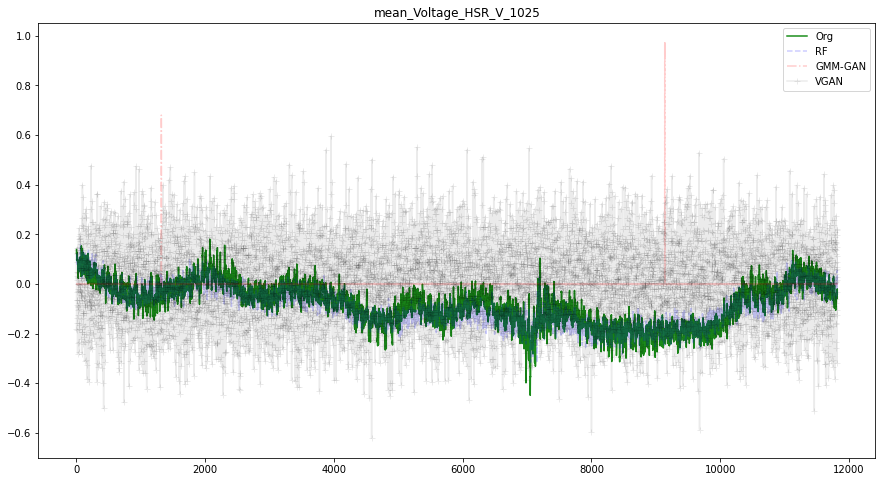

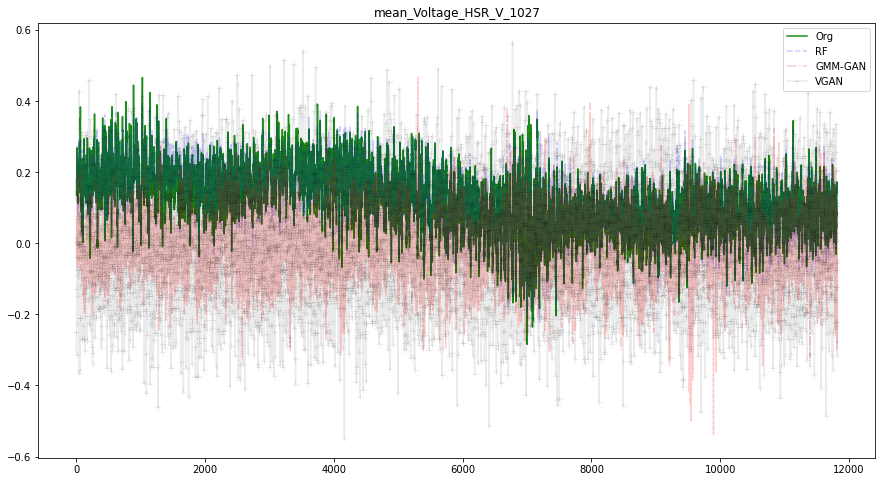

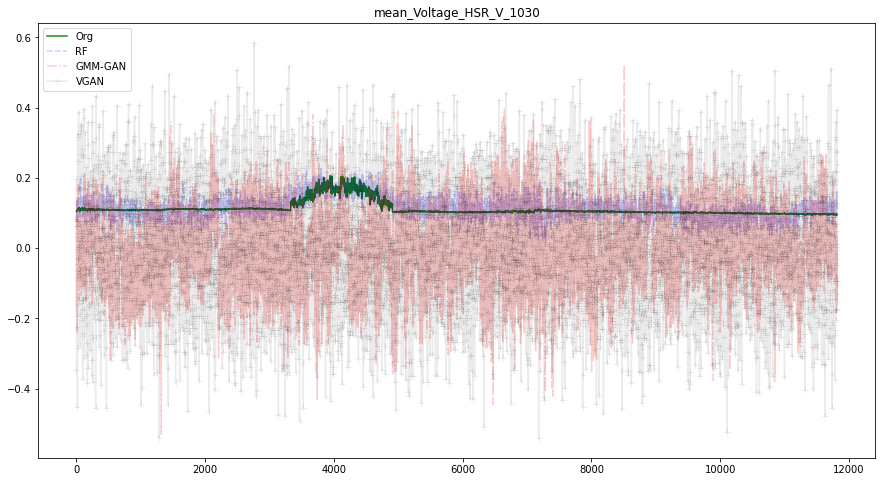

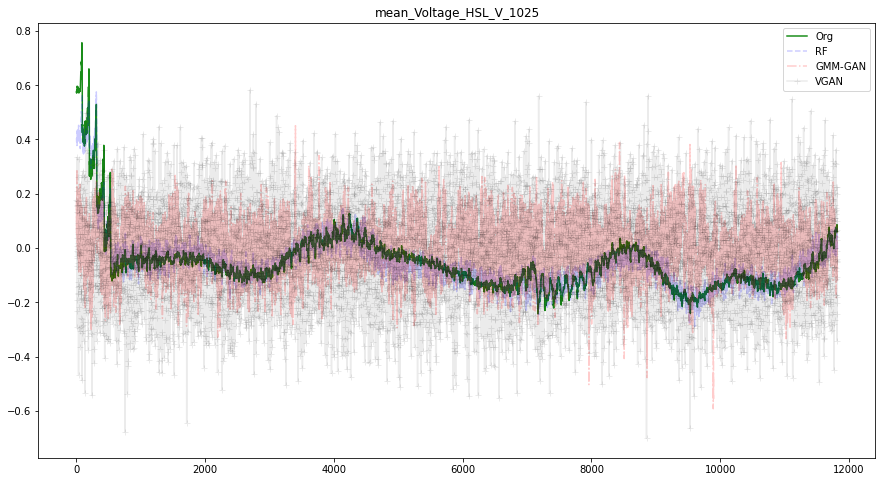

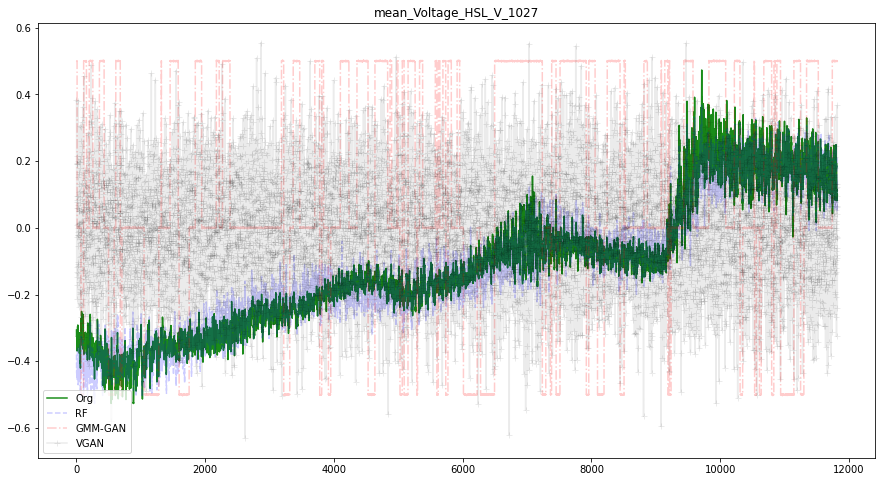

...

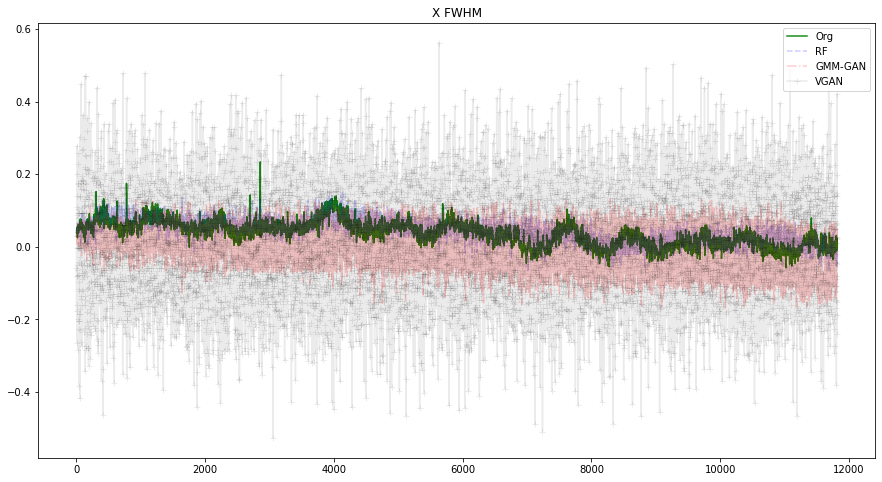

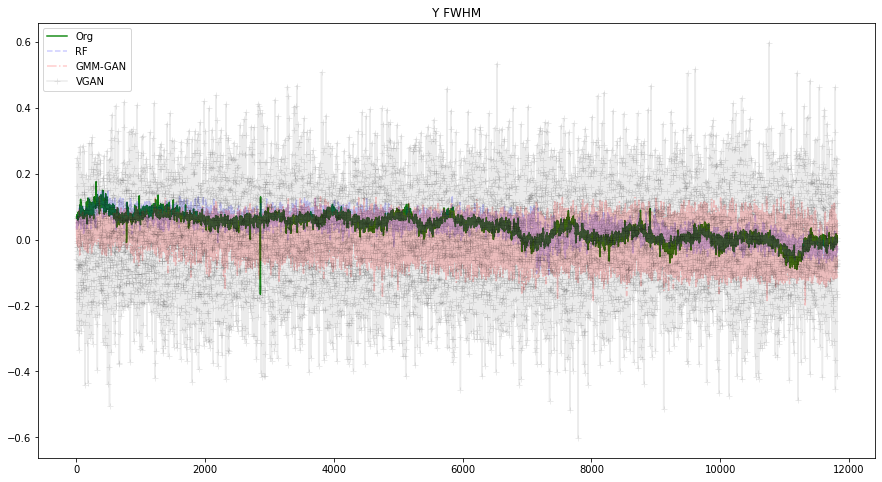

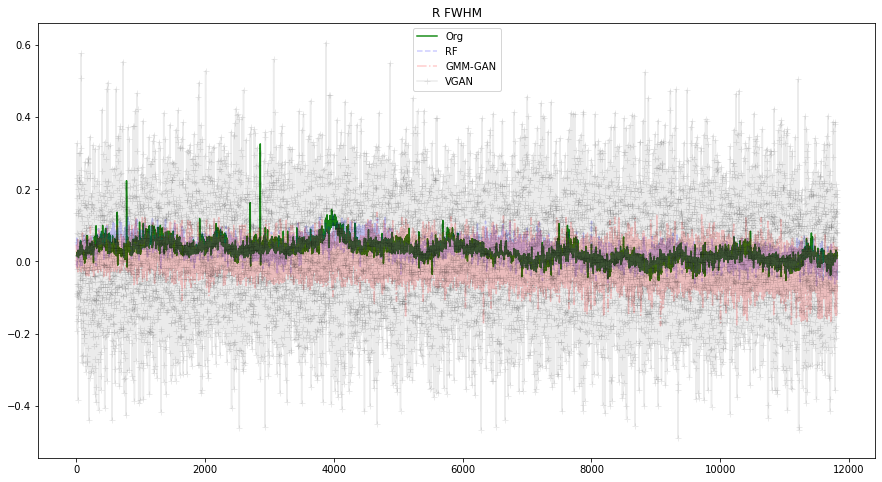

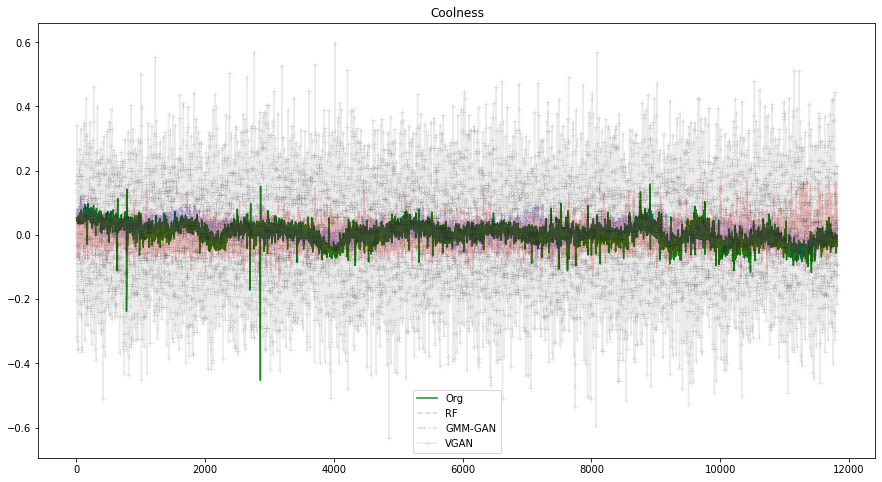

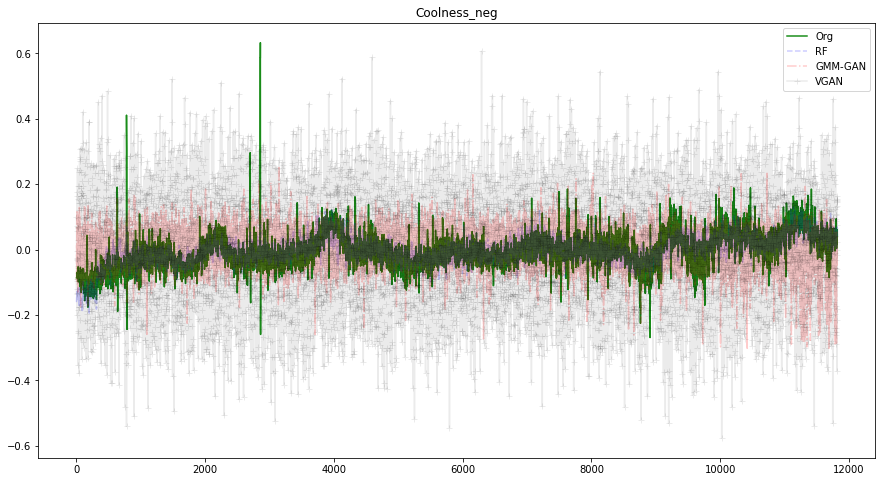

In [626]:
n = x_reduced.shape[1]
# fig, axs = plt.subplots(n, 1, figsize=(n, 1))

for i in range(n):
    name = x_reduced.columns[i]
    plt.figure(figsize=(15, 8))
    plt.plot(x_reduced.iloc[:, i], 'g-', alpha=.9) 
    plt.plot(x_synthetic_rf_reduced.iloc[:, i], 'b--', alpha=.2) 
    plt.plot(x_synthetic_gmm_gan.iloc[:, i], 'r-.', alpha=.2)
    plt.plot(x_synthetic_vgan.iloc[:, i], 'k-+', alpha=.08)
    plt.legend(["Org", "RF", "GMM-GAN", "VGAN"])
    plt.title(name)
    plt.show()
    plt.close()


In [597]:
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE


In [599]:
def compute_pca(x_to_pca, n_components=2):
    return PCA(n_components=n_components).fit_transform(x_to_pca)



In [600]:
def compute_tsne(x_to_tsne, n_components=2):
    return TSNE(n_components=n_components, n_iter=300).fit_transform(x_to_tsne)



In [603]:
x_org_pca = compute_pca(x_reduced)
x_rf_pca = compute_pca(x_synthetic_rf_reduced)
x_gmm_gan_pca = compute_pca(x_synthetic_gmm_gan)
x_vgan_pca = compute_pca(x_synthetic_vgan)


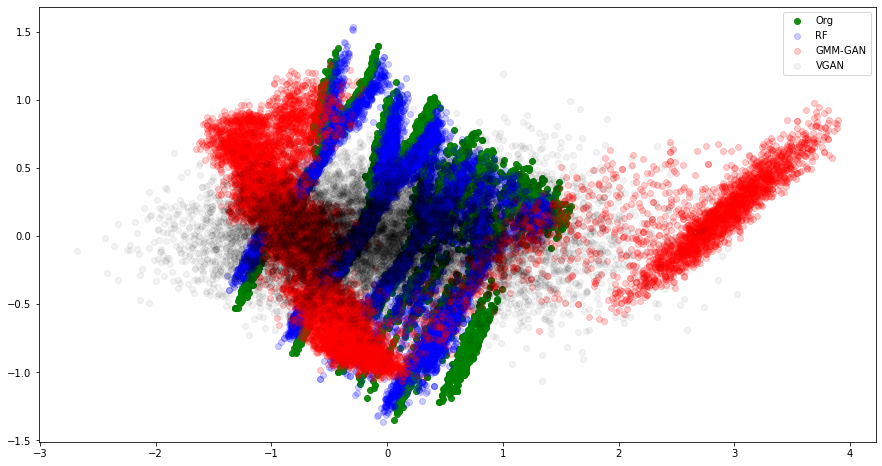

In [633]:

plt.figure(figsize=(15, 8))
plt.scatter(x_org_pca[:, 0], x_org_pca[:, 1], alpha=.9, c="g")
plt.scatter(x_rf_pca[:, 0], x_rf_pca[:, 1], alpha=.2, c="b")
plt.scatter(x_gmm_gan_pca[:, 0], x_gmm_gan_pca[:, 1], alpha=.2, c="r")
plt.scatter(x_vgan_pca[:, 0], x_vgan_pca[:, 1], alpha=.05, c="k")

plt.legend(["Org", "RF", "GMM-GAN", "VGAN"])
plt.show()

In [605]:
x_org_tsne = compute_tsne(x_reduced)
x_rf_tsne = compute_tsne(x_synthetic_rf_reduced)
x_gmm_gan_tsne = compute_tsne(x_synthetic_gmm_gan)
x_vgan_tsne = compute_tsne(x_synthetic_vgan)



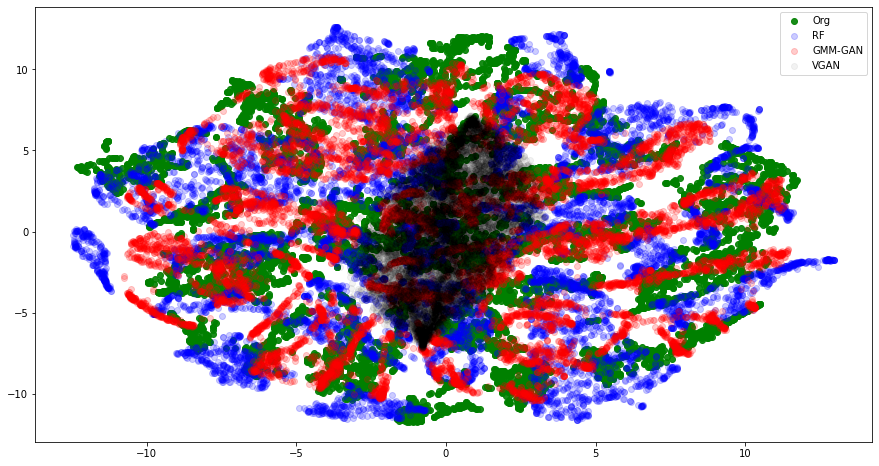

In [634]:

plt.figure(figsize=(15, 8))
plt.scatter(x_org_tsne[:, 0], x_org_tsne[:, 1], alpha=.9, c="g")
plt.scatter(x_rf_tsne[:, 0], x_rf_tsne[:, 1], alpha=.2, c="b")
plt.scatter(x_gmm_gan_tsne[:, 0], x_gmm_gan_tsne[:, 1], alpha=.2, c="r")
plt.scatter(x_vgan_tsne[:, 0], x_vgan_tsne[:, 1], alpha=.05, c="k")

plt.legend(["Org", "RF", "GMM-GAN", "VGAN"])
plt.show()